<a href="https://colab.research.google.com/github/econeutics/18065/blob/main/spectral_clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Requirements



In [ ]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 661.6/661.6 kB 6.0 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for torch_geometric: filename=torch_geometric-2.3.1-py3-none-any.whl size=910454 sha256=7c7cb60643e78e910d44e1d40ad4cce74c0c929f25afc51c7284291c0df19532
  Stored in directory: /root/.cache/pip/wheels/ac/dc/30/e2874821ff308ee67dcd7a66dbde912411e19e35a1addda028
Successfully built torch_geometric


In [ ]:
import time
import os
import networkx as nx
import numpy as np
import scipy as sp
import matplotlib
import matplotlib.pyplot as plt

from scipy.cluster.vq import whiten, kmeans
from numpy import linalg as LA
from networkx.algorithms.cuts import conductance
from scipy.sparse.linalg import eigsh

import torch
import torch_geometric

import tarfile
from google.colab import files
import pandas as pd

%matplotlib inline
matplotlib.rcParams.update({'font.size': 20})

# Loading Datasets

## Facebook

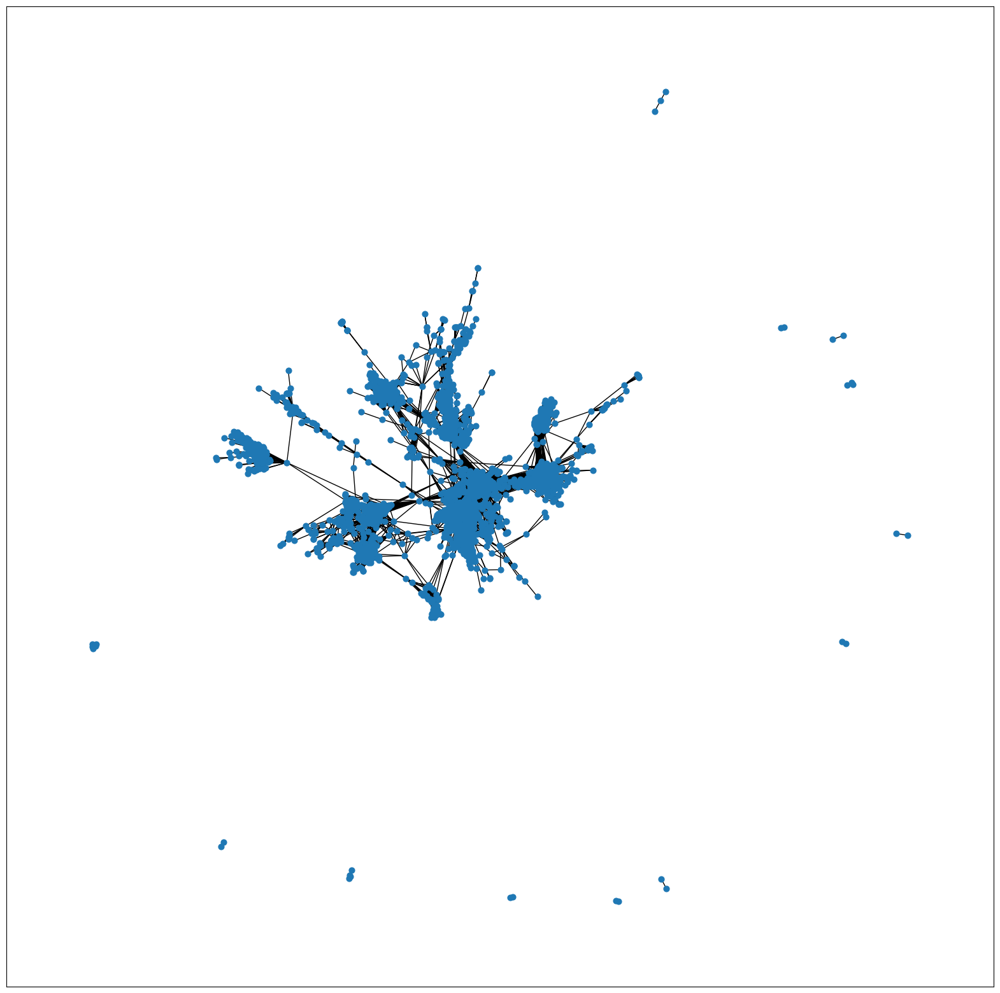

In [ ]:
file = tarfile.open('facebook.tar.gz')
file.extractall('./')
file.close()
facebook_files = os.listdir("facebook")
facebook_edges = [name for name in facebook_files if "edges" in name]

facebook_graph = nx.Graph()

for part in facebook_edges:
  path = "facebook/"+ part
  part_graph = nx.read_edgelist(path, nodetype=int).to_undirected()
  facebook_graph.add_edges_from(part_graph.edges)

fig, ax = plt.subplots(1, 1, figsize=(20, 20))
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False, node_size = 40)

There are 32 nodes in 7 subgraphs that are fully disconnected from the biggest (core) subgraph. I will trim these nodes out of convenience

In [ ]:
fb_disconnected = []
fb_subgraphs = nx.connected_components(facebook_graph)

for subgraph in fb_subgraphs:

  if len(subgraph) < 100:
    fb_disconnected.extend(list(subgraph))

facebook_graph.remove_nodes_from(fb_disconnected)

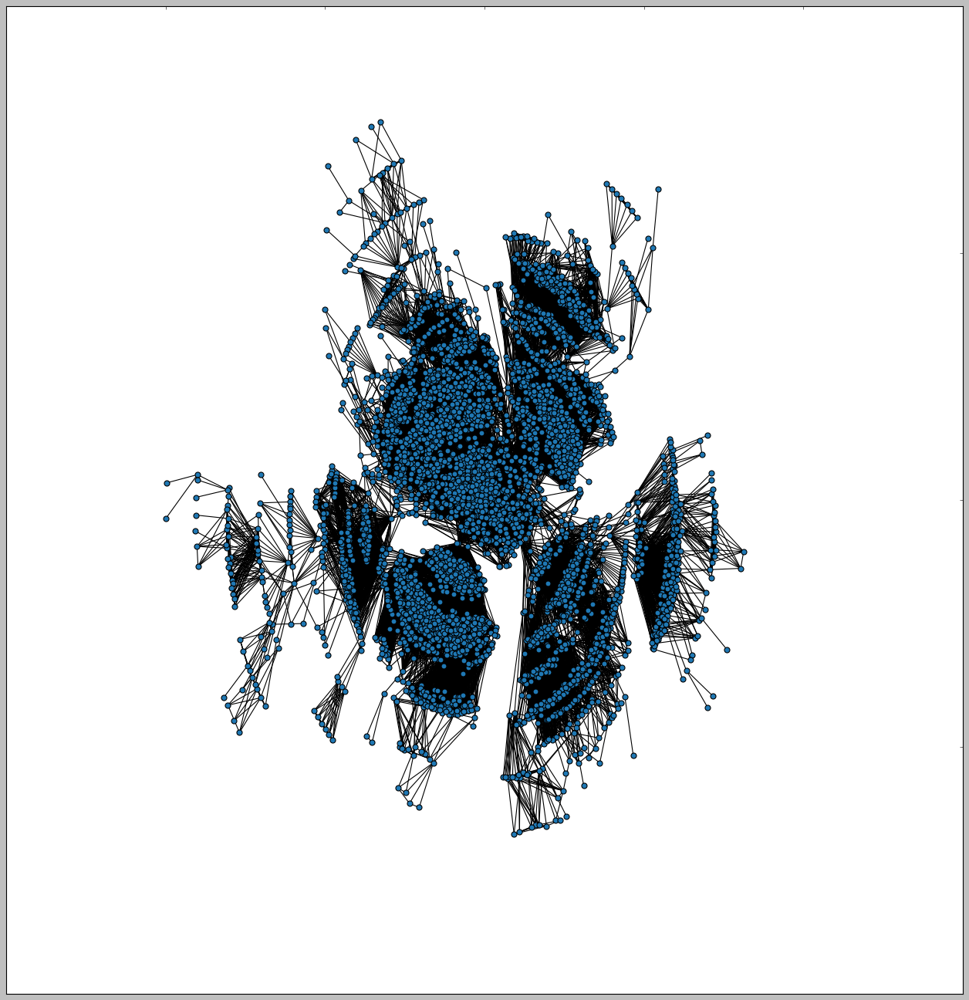

In [ ]:
facebook_layout = nx.kamada_kawai_layout(facebook_graph)
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False, node_size = 40,
                 pos = facebook_layout)
plt.savefig("fig1_facebook.png", dpi = 400)

## Cora

In [ ]:
cora_graph = torch_geometric.datasets.Planetoid("./", "Cora")
cora_graph.download()
cora_graph.get_summary()

Processing...
Done!
Using existing file ind.cora.x
Using existing file ind.cora.tx
Using existing file ind.cora.allx
Using existing file ind.cora.y
Using existing file ind.cora.ty
Using existing file ind.cora.ally
Using existing file ind.cora.graph
Using existing file ind.cora.test.index


Planetoid (#graphs=1):
+------------+----------+----------+
|            |   #nodes |   #edges |
|------------+----------+----------|
| mean       |     2708 |    10556 |
| std        |      nan |      nan |
| min        |     2708 |    10556 |
| quantile25 |     2708 |    10556 |
| median     |     2708 |    10556 |
| quantile75 |     2708 |    10556 |
| max        |     2708 |    10556 |
+------------+----------+----------+

In [ ]:
cora_graph = cora_graph[0]

In [ ]:
cora_graph = torch_geometric.utils.to_networkx(cora_graph, to_undirected = True,remove_self_loops=True)

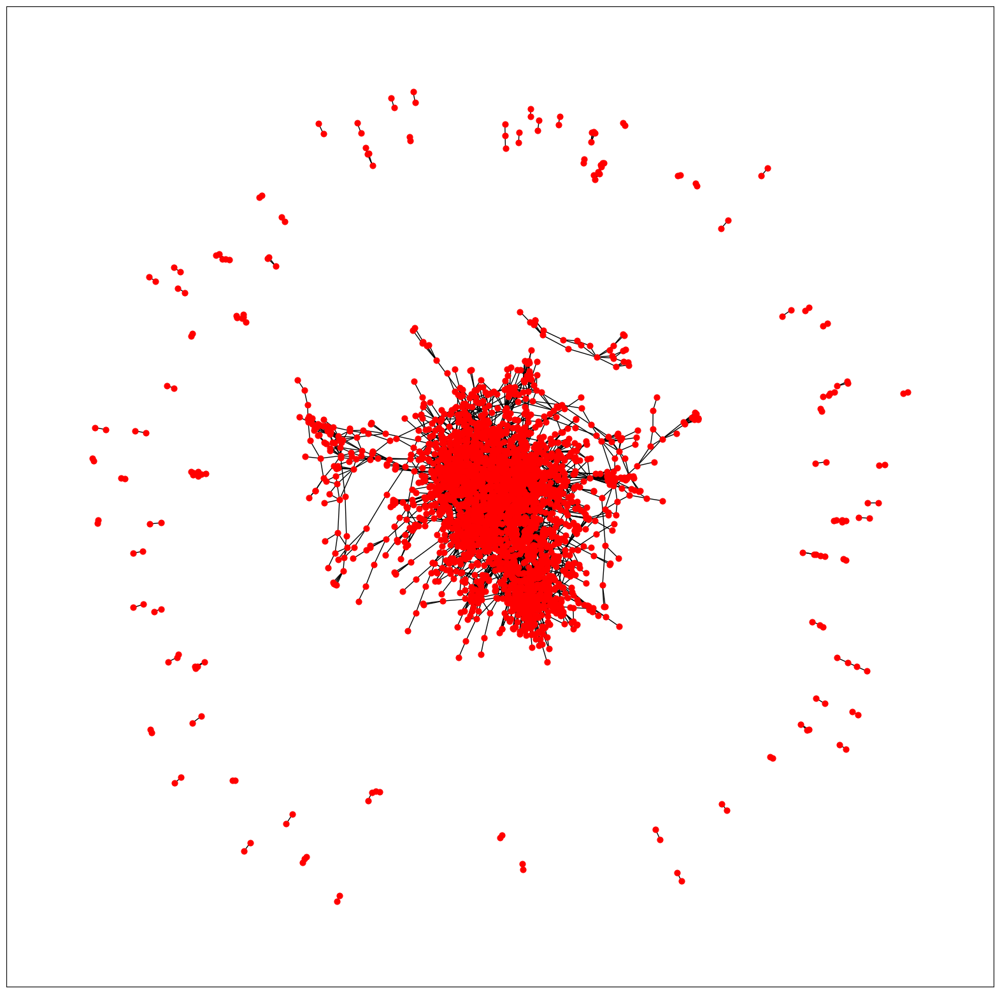

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
nx.draw_networkx(cora_graph, ax=ax, with_labels=False, node_size = 40,node_color = "red")

In this case there are 200+ nodes in 28 subgraphs that are not fully connected

In [ ]:
plt.style.use('classic')
cora_disconnected = []
cora_subgraphs = nx.connected_components(cora_graph)

for subgraph in cora_subgraphs:

  if len(subgraph) < 100:
    cora_disconnected.extend(list(subgraph))

cora_graph.remove_nodes_from(cora_disconnected)

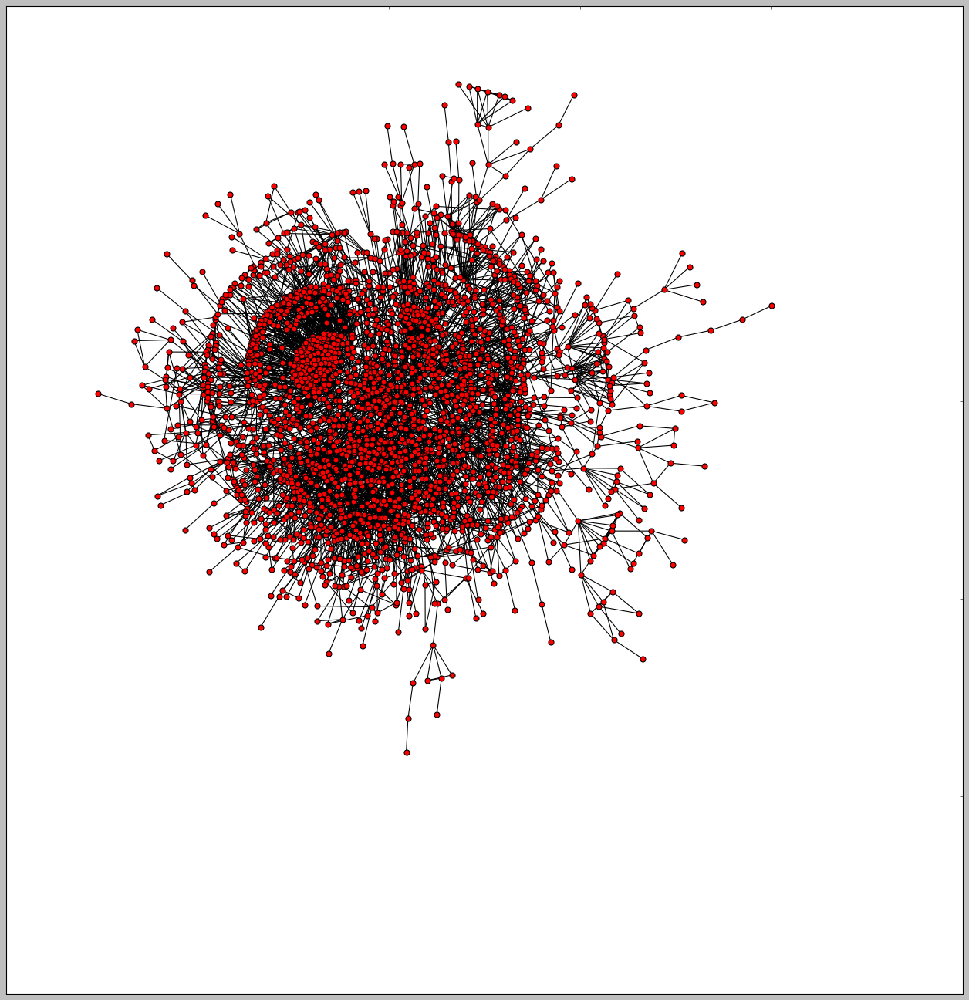

In [ ]:
cora_layout = nx.kamada_kawai_layout(cora_graph)
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
nx.draw_networkx(cora_graph, ax=ax, with_labels=False, node_size = 40,
                 node_color = "red",
                 pos = cora_layout)
plt.savefig("fig2_cora.png", dpi = 450)

## Twitch Gamers

Obtained from [this repository](https://github.com/CUAI/Non-Homophily-Benchmarks/tree/main/data/twitch/ES). Although loader options available I just took a small subset of the data: Spanish-speaking streamers and downloaded it locally

In [ ]:
twitch_edges = np.loadtxt("twitch_es/musae_ES_edges.csv",
                 delimiter=",", dtype=int)
twitch_graph = nx.Graph()
twitch_graph.add_edges_from(twitch_edges)



In [ ]:
twitch_layout = nx.kamada_kawai_layout(twitch_graph)

fig, ax = plt.subplots(1, 1, figsize=(20, 20))
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95, node_color = "green",
                 pos = twitch_layout)
plt.savefig("fig3_twitch.png", dpi = 450)

# Part A

## Descriptive plots and stats

In [ ]:
def eig_laplacian(A, k=2):
    n = np.shape(A)[0]

    #Regularized Laplacian
    D = np.diag(1 / np.sqrt(np.ravel(A.sum(axis=0))))
    L = np.identity(n) - D.dot(A).dot(D)
    return eigsh(L, k, which='SM')

### Randomness-related

In [ ]:
def random_adjusted_gap(graph):


  A = nx.adjacency_matrix(graph).toarray()
  n = A.shape[0]
  v, _ = eig_laplacian(A,k =n)

  return(v[n-2] - v[1])


In [ ]:
for name,graph in (("Facebook",facebook_graph ),
 ("Cora",cora_graph ),("Twitch", twitch_graph ) ):

  print(name+ "  "+ str(random_adjusted_gap(graph)))


Facebook  1.8282077282299412
Cora  1.9615470701833237
Twitch  1.7136372301128948


### Connectedness related

In [ ]:
def expected_degree(graph):
  return (2*graph.number_of_edges())/graph.number_of_nodes()

def stdv_degree(graph):

  nodes = graph.nodes
  degree = [graph.degree(d) for d in nodes]

  return(np.array(degree).std())

def std_degree(graph):

  return(expected_degree(graph)/stdv_degree(graph))


def theory_adjusted_degree(graph):

  n = graph.number_of_nodes()
  d = nx.density(graph)
  t_var = np.sqrt(d*(1-d)*n)
  var = stdv_degree(graph)

  return(expected_degree(graph)*(var - t_var)/(t_var*var))

def max_eigenvector_centrality(graph):

  central = nx.eigenvector_centrality(graph)
  central = np.array(list(central.values())).max()

  return central


In [ ]:
q = nx.eigenvector_centrality(facebook_graph)
np.array(list(q.values())).max()

0.08751556459453343

In [ ]:
print("Standard dv of the degree")
for name,graph in (("Facebook",facebook_graph ),
 ("Cora",cora_graph ),("Twitch", twitch_graph ) ):

  print(name+ "  "+ str(stdv_degree(graph)))

Standard dv of the degree
Facebook  46.334259789444786
Cora  5.405274409838582
Twitch  49.39454336108033


In [ ]:
print("Standardized degree")
for name,graph in (("Facebook",facebook_graph ),
 ("Cora",cora_graph ),("Twitch", twitch_graph ) ):

  print(name+ "  "+ str(std_degree(graph)))

Standardized degree
Facebook  0.925615316391208
Cora  0.7547587336148387
Twitch  0.5172967168679019


In [ ]:
print("Theory-adjusted degree")
for name,graph in (("Facebook",facebook_graph ),
 ("Cora",cora_graph ),("Twitch", twitch_graph ) ):

  print(name+ "  "+ str(theory_adjusted_degree(graph)))

Theory-adjusted degree
Facebook  5.658482134897706
Cora  1.2663164902590522
Twitch  4.550975219123112


In [ ]:
5.658482134897706/46.334259789444786

0.1221230717963631

In [ ]:
1.2663164902590522/5.405274409838582

0.23427422814170656

In [ ]:
4.550975219123112/49.39454336108033

0.09213518152916021

In [ ]:
print("Max-eigenvector centrality")
for name,graph in (("Facebook",facebook_graph ),
 ("Cora",cora_graph ),("Twitch", twitch_graph ) ):

  print(name+ "  "+ str(max_eigenvector_centrality(graph)))

Max-eigenvector centrality
Facebook  0.08751556459453343
Cora  0.6542996956637285
Twitch  0.15434161619479123


# Part B

Constructing 2 clustering functions (Vanilla (or Amini with input A + reg) & Chaudhuri)

In [ ]:
def spectral_clust(A, k=2):
    n = np.shape(A)[0]
    V, Z = eig_laplacian(A, k)

    rows_norm = np.linalg.norm(Z, axis=1, ord=2)
    Y = (Z.T / rows_norm).T
    centroids, distortion = kmeans(Y, k)

    y_hat = np.zeros(n, dtype=int)
    for i in range(n):
        dists = np.array([np.linalg.norm(Y[i] - centroids[c]) for c in range(k)])
        y_hat[i] = np.argmin(dists)
    return y_hat

def spectral_clust_chauduri(A, tau, k=2):
    n = np.shape(A)[0]
    At = A + tau / n
    D = np.diag(1 / np.sqrt(np.ravel(At.sum(axis=0))))
    L = np.identity(n) - D.dot(A).dot(D)
    V, Z = eigsh(L, k, which='SM')

    rows_norm = np.linalg.norm(Z, axis=1, ord=2)
    Y = (Z.T / rows_norm).T
    centroids, distortion = kmeans(Y, k)

    y_hat = np.zeros(n, dtype=int)
    for i in range(n):
        dists = np.array([np.linalg.norm(Y[i] - centroids[c]) for c in range(k)])
        y_hat[i] = np.argmin(dists)
    return y_hat

Next I build functions for tunning tau in both cases, as well as other metrics

In [ ]:
def compute_min_conductance(graph, labels):

  nodes = np.array(list(graph.nodes()))
  clusters_list = []
  levels = np.unique(labels)

  for cluster in levels:

    nodes_set = nodes[labels == cluster]
    clusters_list.append(nodes_set)

  score = min(conductance(graph, cluster_i) for cluster_i in clusters_list)

  return(score)



def conductance_tuning_full(graph,
                            param_space = np.logspace(-7,12, 400),
                            k = 2):

  reg_cond, reg_chud_cond = [], []

  N = graph.number_of_nodes()
  S = nx.adjacency_matrix(graph).toarray()

  vanilla_clusters = spectral_clust(S, k = k)
  vanilla_cond = compute_min_conductance(graph, vanilla_clusters)

  for tau in param_space:

    SR = S + tau / N

    reg_clusters = spectral_clust(SR, k = k)
    reg_chud_clusters = spectral_clust_chauduri(S, tau=tau,k = k)


    reg_cond.append(compute_min_conductance(graph,reg_clusters ))
    reg_chud_cond.append(compute_min_conductance(graph,reg_chud_clusters ))


  return vanilla_cond, reg_cond, reg_chud_cond, N

## Tunning for K = 2, ..., 7

In [ ]:
tau_space = np.logspace(-4,4, 60)

## Matrix results for 60 tau values, and 6 x 3 partitions
results_fb_vanilla = np.zeros(6)
results_fb = np.zeros((60,6))
results_fb_chud = np.zeros((60,6))

for i in range(2,8):

  index =  i-2

  vanilla, reg, reg_chud, _ = conductance_tuning_full(facebook_graph,
                                                      tau_space, k = i)
  results_fb_vanilla[index] = vanilla
  results_fb[:, index] = reg
  results_fb_chud[:, index] = reg_chud

In [ ]:
import pandas as pd
tau_space = np.logspace(-4,4, 60)

## Matrix results for 60 tau values, and 6 x 3 partitions
results_cora_vanilla = np.zeros(6)
results_cora = np.zeros((60,6))
results_cora_chud = np.zeros((60,6))

for i in range(2,8):

  index =  i-2

  vanilla, reg, reg_chud, _ = conductance_tuning_full(cora_graph,
                                                      tau_space, k = i)
  results_cora_vanilla[index] = vanilla
  results_cora[:, index] = reg
  results_cora_chud[:, index] = reg_chud

In [ ]:
## Matrix results for 60 tau values, and 6 x 3 partitions
results_twitch_vanilla = np.zeros(6)
results_twitch = np.zeros((60,6))
results_twitch_chud = np.zeros((60,6))

for i in range(2,8):

  index =  i-2

  vanilla, reg, reg_chud, _ = conductance_tuning_full(twitch_graph,
                                                      tau_space, k = i)
  results_twitch_vanilla[index] = vanilla
  results_twitch[:, index] = reg
  results_twitch_chud[:, index] = reg_chud

In [ ]:
tau_space = np.logspace(-4,4, 60)

## Best-tuned parameter results and graphs


In [ ]:
tau_space_ticks = [0.001,"","","","","","","","","","","","", 0.0057,"",
                   "","","","","","","","","","","",
                   0.335,"","","","","","", 2.98,"","","","","","","","","",67.6,
                   "","","","","","","",822.7,"","","","","","","","10,000"]

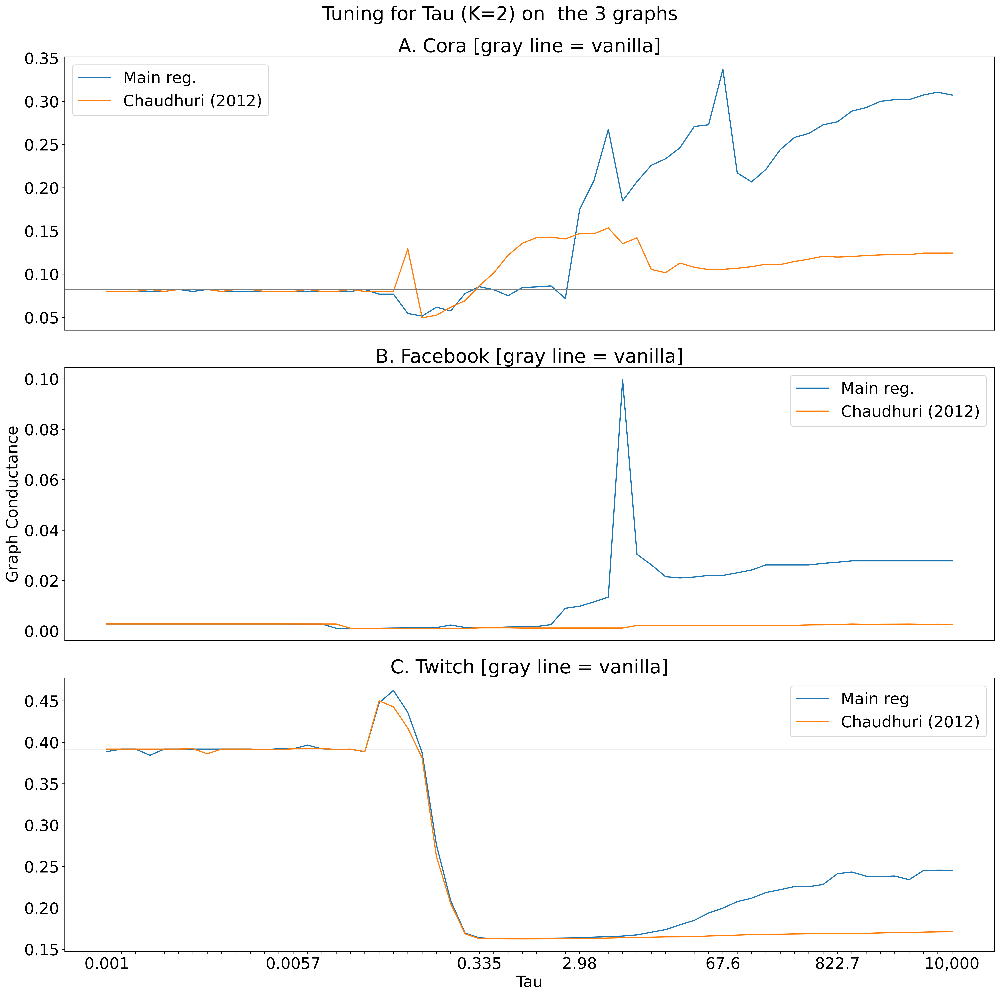

In [ ]:


fig, ax = plt.subplots(3, 1, figsize=(18, 18), dpi=400)
plt.locator_params(axis='x', nbins=5)
ax[0].plot(results_cora[:,0], label="Main reg.")
ax[0].plot(results_cora_chud[:,0], label="Chaudhuri (2012)")
ax[0].axhline(results_cora_vanilla[0],linewidth = 0.6,color ="gray")
ax[0].set_title("A. Cora [gray line = vanilla]")
ax[0].set_xticks([], [])
ax[0].legend()
ax[1].plot(results_fb[:,0], label="Main reg.")
ax[1].plot(results_fb_chud[:,0], label="Chaudhuri (2012)")
ax[1].axhline(results_fb_vanilla[0],linewidth = 0.6,color ="gray")
ax[1].set_title("B. Facebook [gray line = vanilla]")
ax[1].set_ylabel("Graph Conductance")
ax[1].set_xticks([], [])
ax[1].legend()
ax[2].plot(results_twitch[:,0], label="Main reg")
ax[2].plot(results_twitch_chud[:,0], label="Chaudhuri (2012)")
ax[2].axhline(results_twitch_vanilla[0],linewidth = 0.6,color ="gray")
ax[2].set_title("C. Twitch [gray line = vanilla]")
ax[2].legend()
ax[2].set_xticks(range(len(tau_space)), list(tau_space_ticks))
plt.suptitle("Tuning for Tau (K=2) on  the 3 graphs")
plt.xlabel("Tau")
plt.tight_layout()
plt.savefig("FigB1_tuning.png")
plt.show()

### Appendix: results for high k

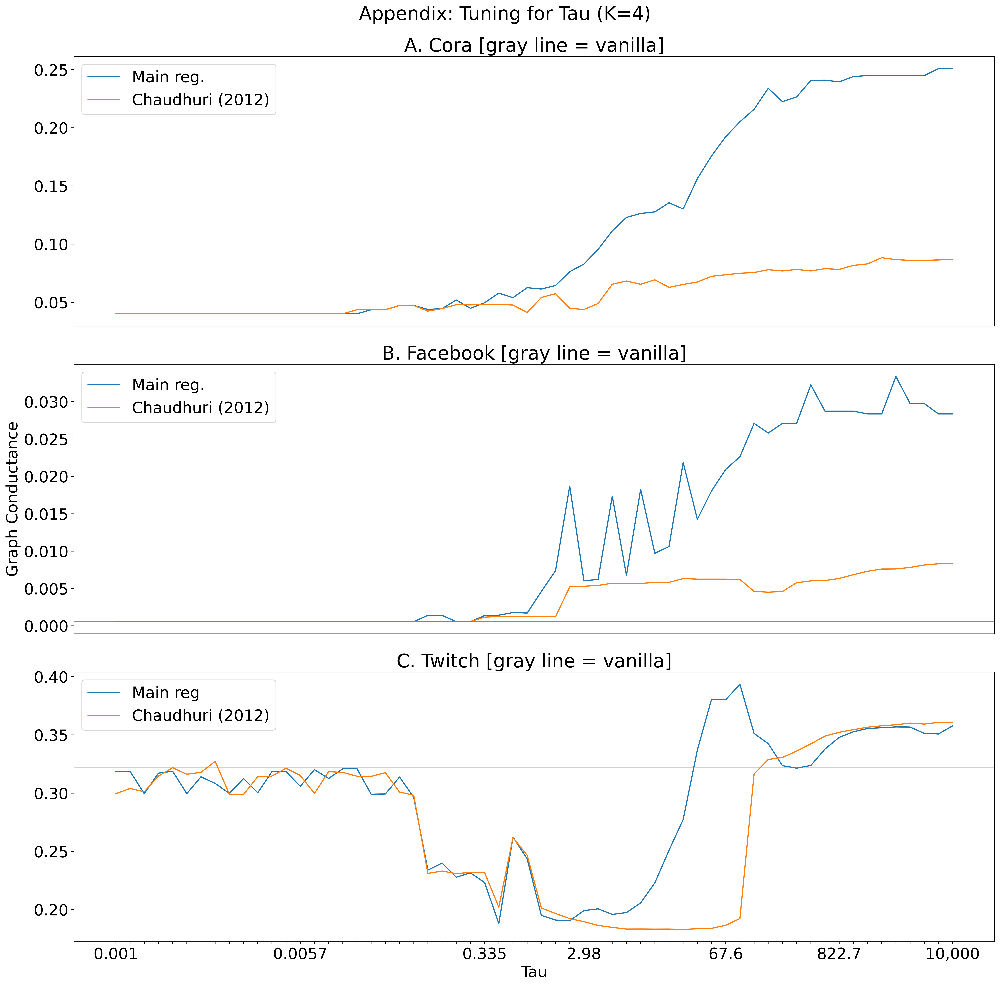

In [ ]:
fig, ax = plt.subplots(3, 1, figsize=(18, 18), dpi=400)
ax[0].plot(results_cora[:,3], label="Main reg.")
ax[0].plot(results_cora_chud[:,3], label="Chaudhuri (2012)")
ax[0].axhline(results_cora_vanilla[3],linewidth = 0.6,color ="gray")
ax[0].set_title("A. Cora [gray line = vanilla]")
ax[0].set_xticks([],[])
ax[0].legend()
ax[1].plot(results_fb[:,3], label="Main reg.")
ax[1].plot(results_fb_chud[:,3], label="Chaudhuri (2012)")

ax[1].axhline(results_fb_vanilla[3],linewidth = 0.6,color ="gray")
ax[1].set_title("B. Facebook [gray line = vanilla]")
ax[1].set_xticks([],[])
ax[1].set_ylabel("Graph Conductance")
ax[1].legend()
ax[2].plot(results_twitch[:,3], label="Main reg")
ax[2].plot(results_twitch_chud[:,3], label="Chaudhuri (2012)")
ax[2].axhline(results_twitch_vanilla[3],linewidth = 0.6,color ="gray")
ax[2].set_title("C. Twitch [gray line = vanilla]")
ax[2].legend()
ax[2].set_xticks(range(len(tau_space)), list(tau_space_ticks))
plt.suptitle("Appendix: Tuning for Tau (K=4)")
plt.xlabel("Tau")
plt.tight_layout()
plt.savefig("Appendix_1_tuning.png")
plt.show()

# Part C

## Metrics: conductance

In [ ]:
def best_results(vanilla, reg_results, reg_chud_results):

  results = np.zeros((3, reg_results.shape[1]))
  results[0,:] = vanilla
  results[1,:] = np.min(reg_results, axis = 0 )
  results[2,:] = np.min(reg_chud_results, axis = 0)

  return(results)


def plot_best_results(vanilla, reg_results, reg_chud_results, name):

  results = best_results(vanilla, reg_results, reg_chud_results)

  n_rows, n_cols = results.shape

  bar_width = 0.27
  index = np.arange(n_cols)
  title = 'Conductance asymptotics: ' + name
  names = ["Vanilla", "Reg-SC", "Chaudhuri"]

  fig = plt.figure(figsize=(10, 6))
  #plt.style.use('ggplot')
  plt.style.use('seaborn-dark-palette')

  # Plot bars for each row
  for i in range(n_rows):
    plt.bar(index + i*bar_width, results[i], bar_width, label=f'{names[i]}')

  # Adjust the plot
  plt.xlabel('Number of clusters')
  plt.ylabel('Minimal Conductance')

  plt.title(title)
  plt.xticks(index + bar_width, [f'{i+2}' for i in range(n_cols)])
  plt.legend(loc = "upper right", fontsize = "medium")
  plt.tight_layout()

  plt.show()

  return(fig)











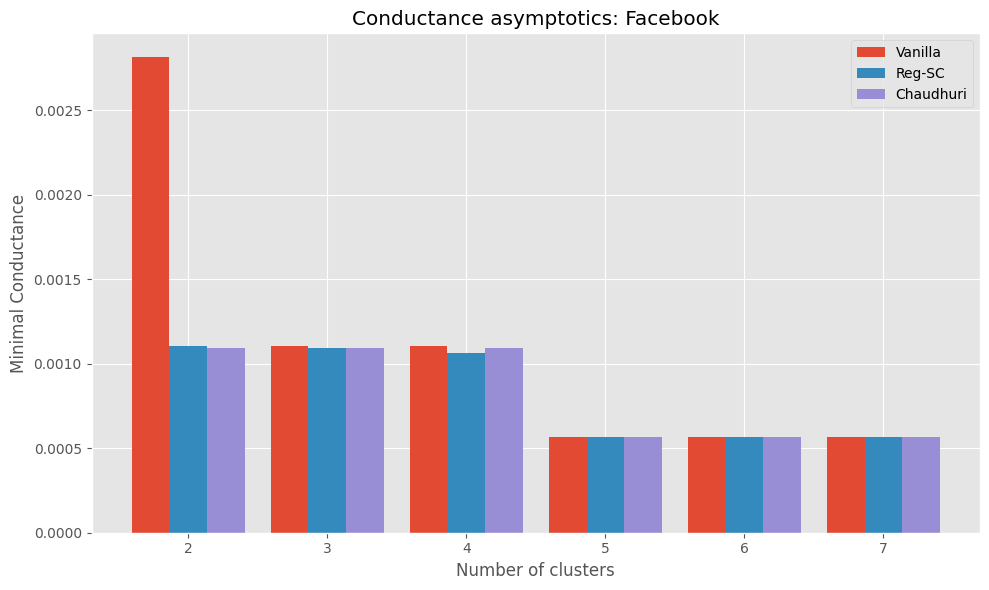

In [ ]:
fig = plot_best_results(results_fb_vanilla, results_fb, results_fb_chud, "Facebook")
fig.savefig("FigC_fb.png", dpi = 400)

<ipython-input-114-c53147201172>:24: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-dark-palette')


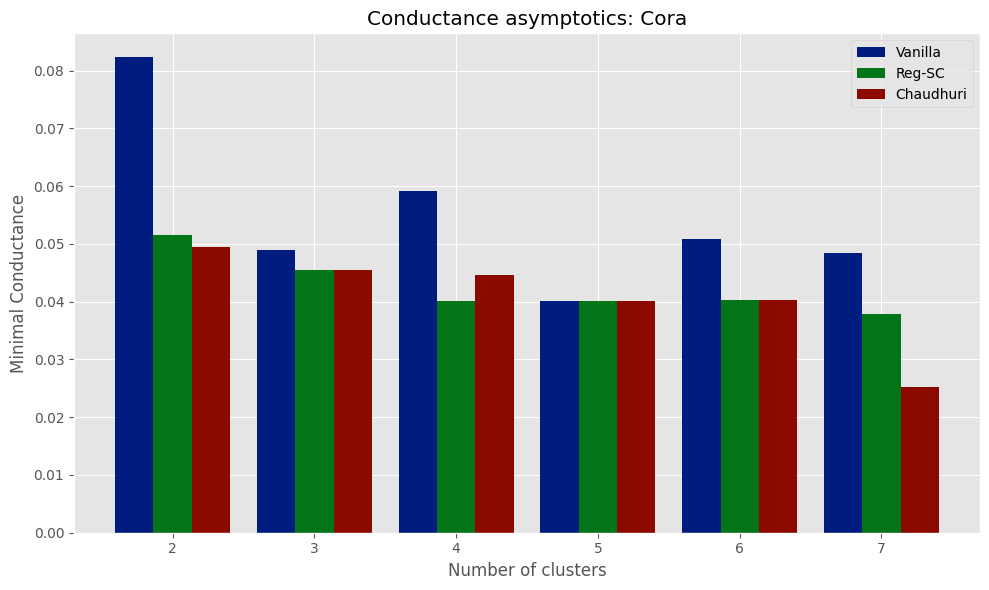

In [ ]:
fig = plot_best_results(results_cora_vanilla, results_cora, results_cora_chud, "Cora")
fig.savefig("FigC_Cora.png", dpi = 400)

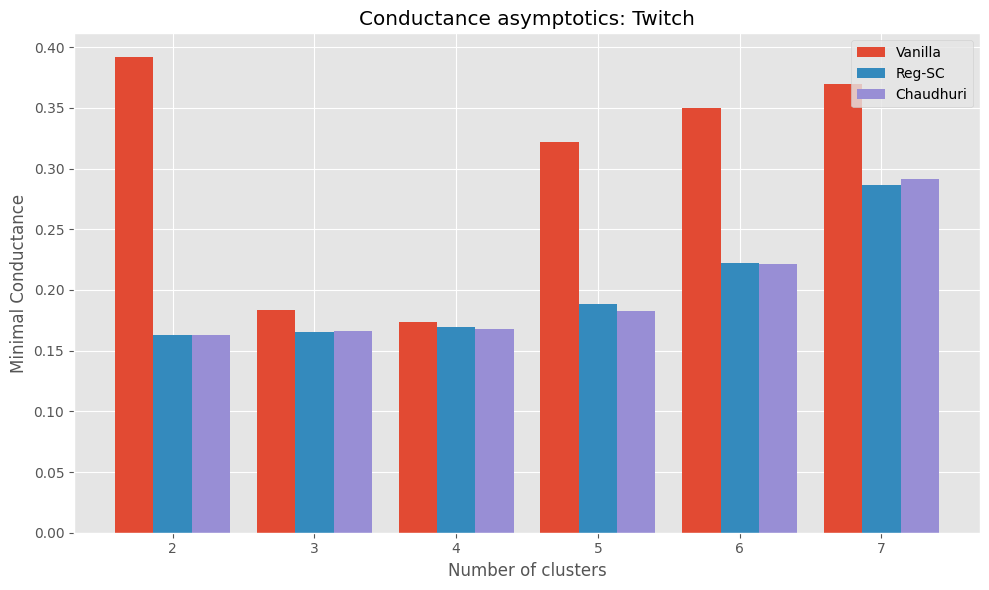

In [ ]:
fig = plot_best_results(results_twitch_vanilla, results_twitch, results_twitch_chud, "Twitch")
fig.savefig("FigC_twitch.png", dpi = 400)

## Plotting Regularized Graphs

In [ ]:
def get_clusters(graph,metrics,tau_space = np.logspace(-4,4,60)):

  N = graph.number_of_nodes()
  S = nx.adjacency_matrix(graph).toarray()
  n_clusters = metrics.shape[1]

  clusters = np.zeros((N,n_clusters))

  for k in range(2, n_clusters +2):

    tau = tau_space[metrics[:, k-2].argmin()]

    SR = S + (tau/N)

    labels = spectral_clust(SR, k = k)

    clusters[:,k-2] = labels

  return(clusters)

def get_clusters_chud(graph,metrics,tau_space = np.logspace(-4,4,60)):

  N = graph.number_of_nodes()
  S = nx.adjacency_matrix(graph).toarray()
  n_clusters = metrics.shape[1]

  clusters = np.zeros((N,n_clusters))

  for k in range(2, n_clusters +2):

    tau = tau_space[metrics[:, k-2].argmin()]


    labels = spectral_clust_chauduri(S, tau = tau, k = k)

    clusters[:,k-2] = labels

  return(clusters)

def node_colors(labels):
    colors = np.empty_like(labels, dtype=object)
    num_clusters = len(np.unique(labels))

    some_colors = ["blue", "red", "green", "orange", "pink", "purple"]

    for cluster in range(num_clusters):

      colors[labels == cluster] = some_colors[cluster]


    return colors




In [ ]:
fb_labels_vanilla = get_clusters(facebook_graph,
                                 results_fb_vanilla.reshape(1,6),
                                 tau_space = np.linspace(0,0,60))

cora_labels_vanilla = get_clusters(cora_graph,
                                 results_cora_vanilla.reshape(1,6),
                                 tau_space = np.linspace(0,0,60))

twitch_labels_vanilla = get_clusters(twitch_graph,
                                 results_twitch_vanilla.reshape(1,6),
                                 tau_space = np.linspace(0,0,60))

In [ ]:

fb_labels = get_clusters(facebook_graph, results_fb)
fb_labels_chud = get_clusters_chud(facebook_graph, results_fb_chud)
cora_labels = get_clusters(cora_graph, results_cora)
cora_labels_chud = get_clusters_chud(cora_graph, results_cora_chud)
twitch_labels = get_clusters(twitch_graph, results_twitch)
twitch_labels_chud = get_clusters_chud(twitch_graph, results_twitch_chud)

fb_labels_vanilla = get_clusters(facebook_graph,
                                 results_fb_vanilla.reshape(1,6),
                                 tau_space = np.linspace(0,0,60))

cora_labels_vanilla = get_clusters(cora_graph,
                                 results_cora_vanilla.reshape(1,6),
                                 tau_space = np.linspace(0,0,60))

twitch_labels_vanilla = get_clusters(twitch_graph,
                                 results_twitch_vanilla.reshape(1,6),
                                 tau_space = np.linspace(0,0,60))

array([[1., 0., 3., 0., 1., 6.],
       [1., 0., 3., 0., 1., 6.],
       [1., 0., 3., 0., 1., 6.],
       ...,
       [1., 2., 1., 4., 4., 4.],
       [1., 2., 1., 4., 4., 4.],
       [1., 2., 1., 4., 4., 4.]])

### Facebook

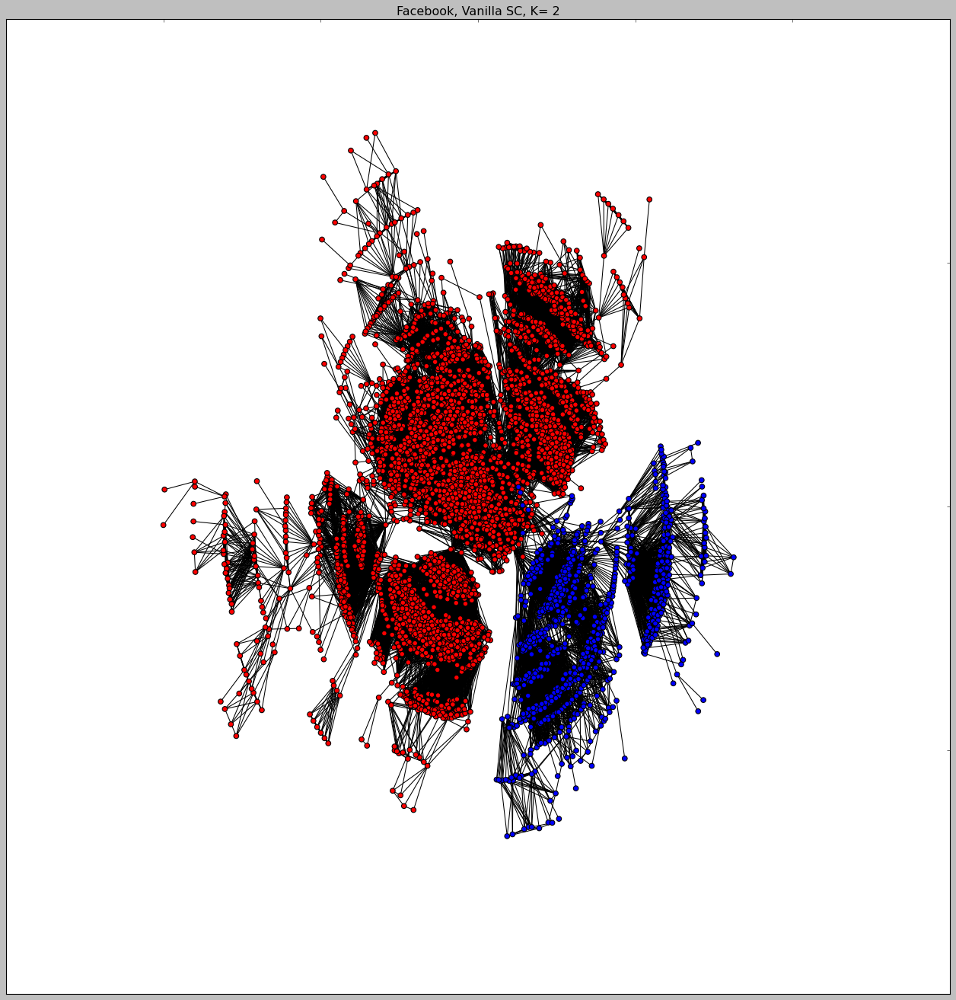

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Vanilla SC, K= 2")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels_vanilla[:,0]),
                 pos=facebook_layout)
plt.savefig("figC_fb_vsc_k2.png", dpi = 400)

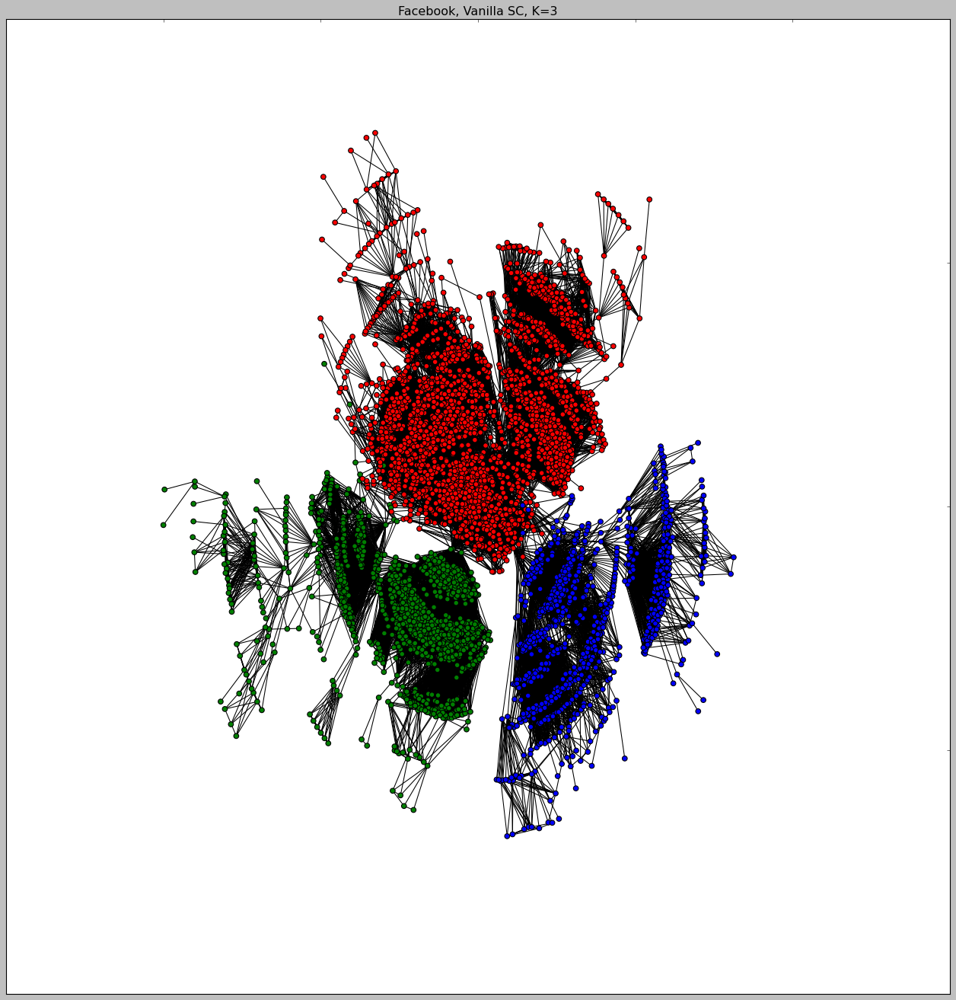

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Vanilla SC, K=3")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels_vanilla[:,1]),
                 pos=facebook_layout)
plt.savefig("figC_fb_vsc_k3.png", dpi = 400)

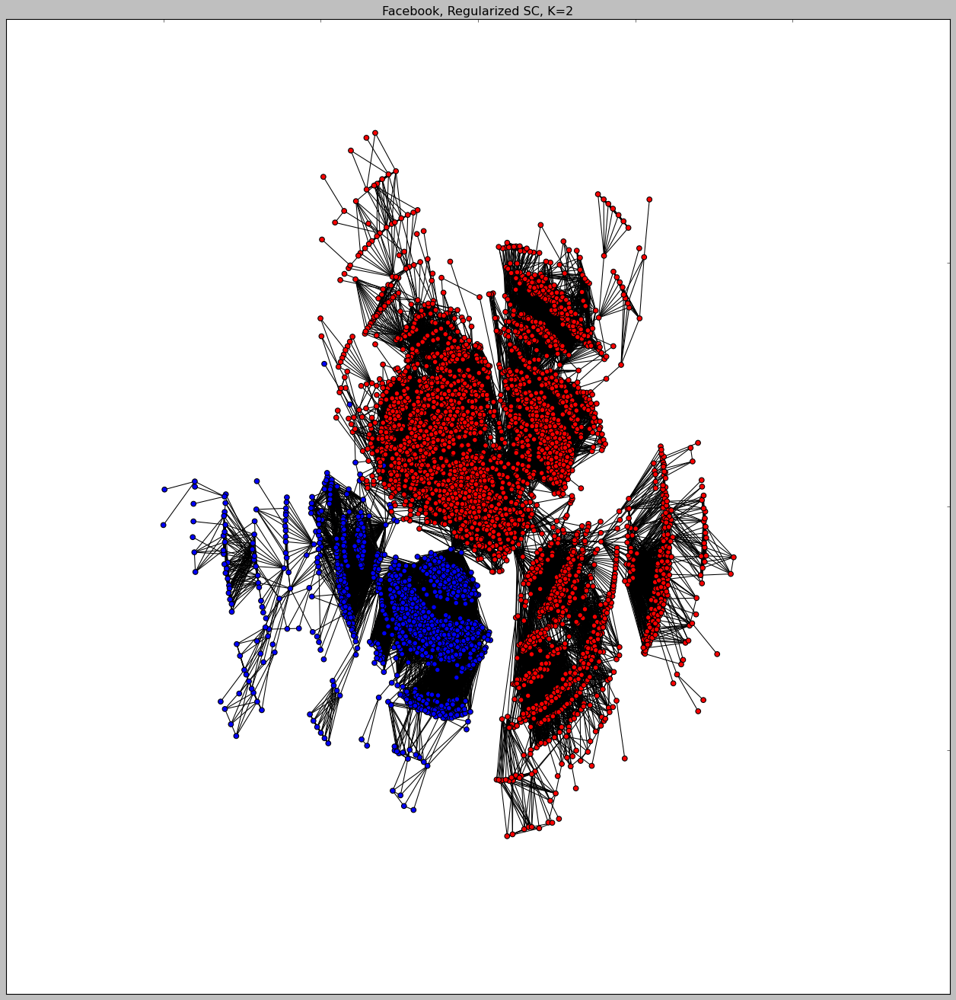

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Regularized SC, K=2")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels[:,0]),
                 pos=facebook_layout)
plt.savefig("figC_fb_rsc_k2.png", dpi = 400)

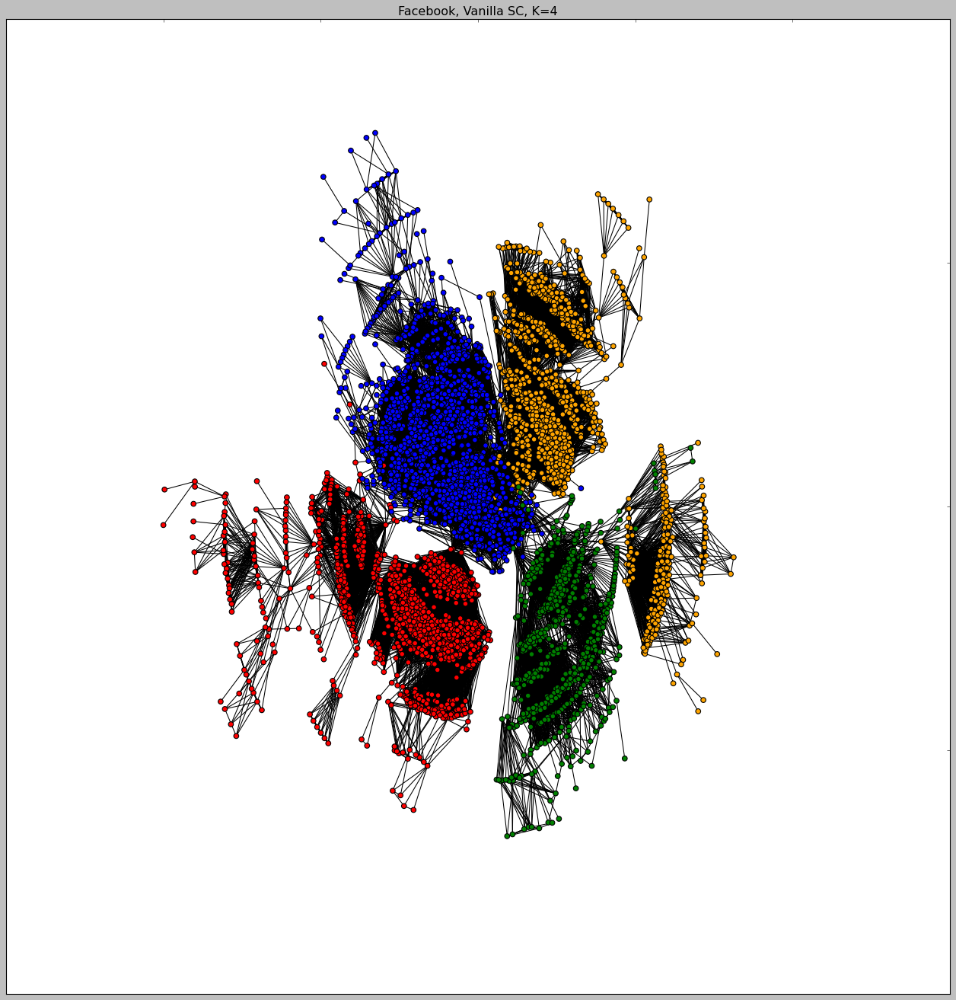

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Vanilla SC, K=4")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels_vanilla[:,2]),
                 pos=facebook_layout)
plt.savefig("figC_fb_vsc_k4.png", dpi = 400)

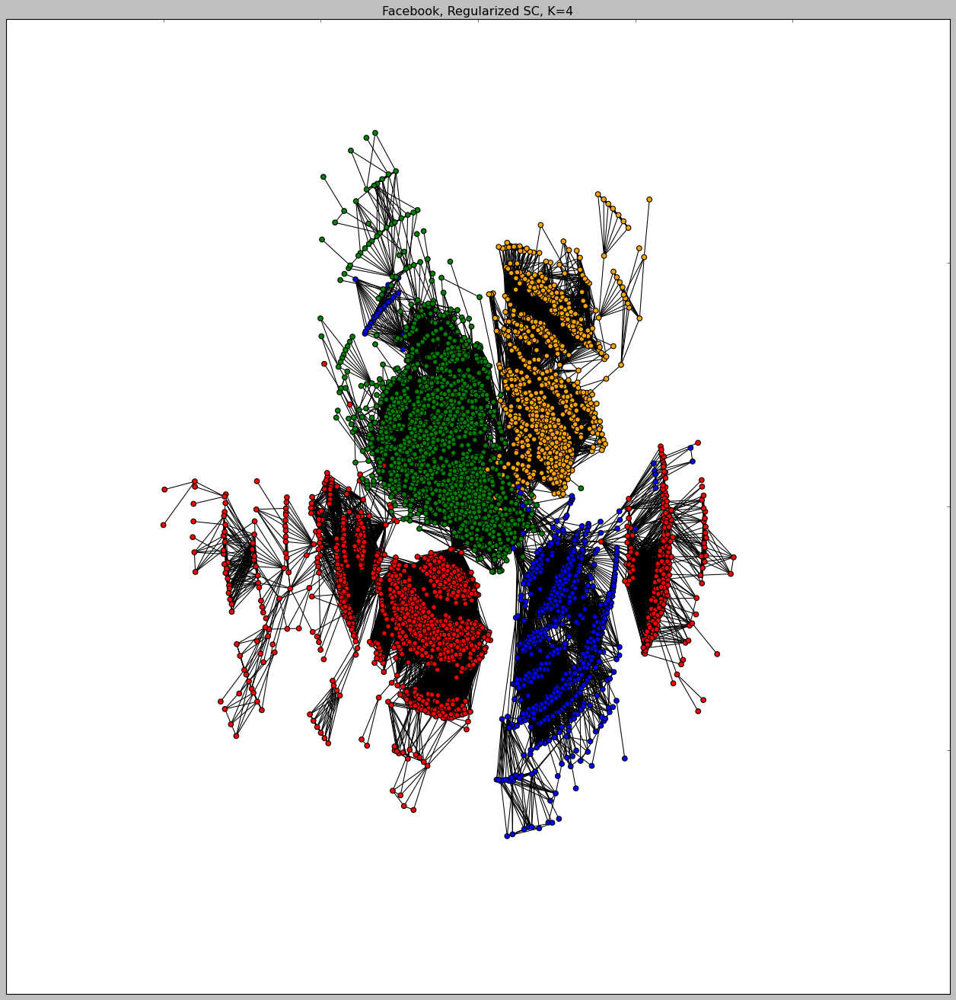

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Regularized SC, K=4")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels[:,2]),
                 pos=facebook_layout)
plt.savefig("figC_fb_rsc_k4.png", dpi = 400)

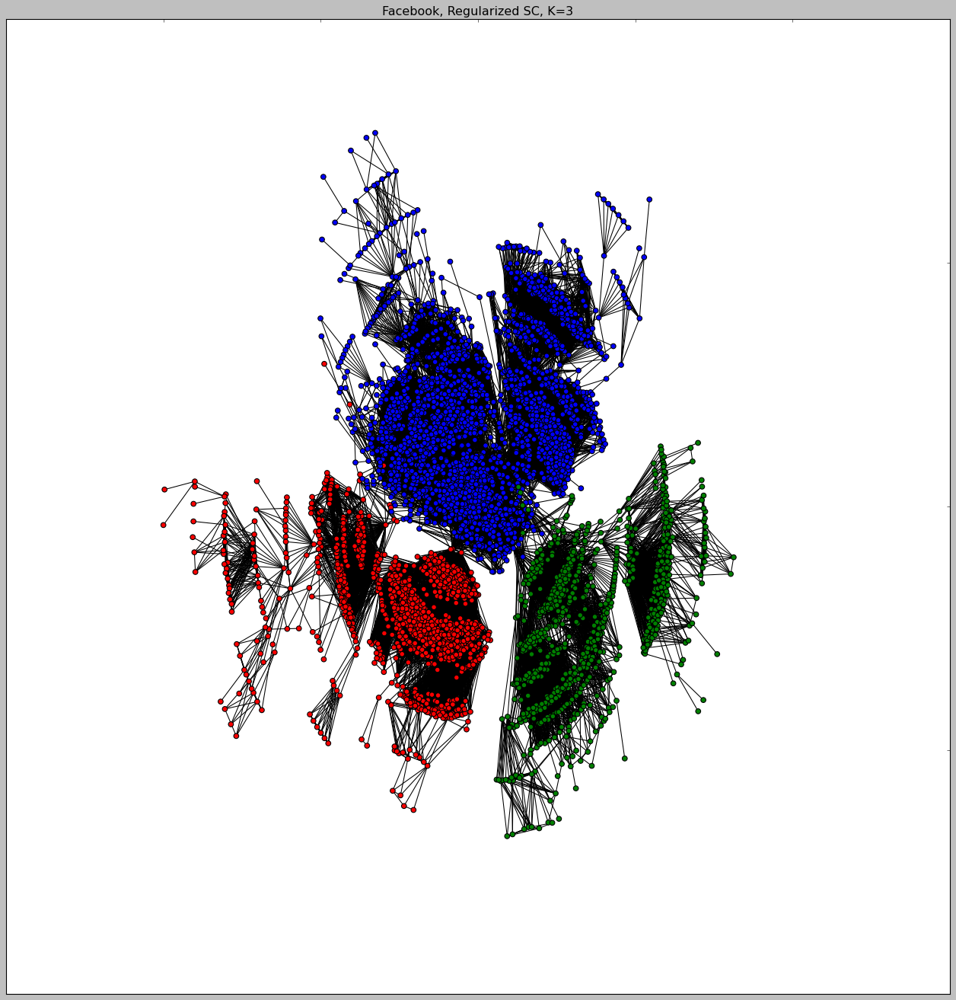

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Regularized SC, K=3")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels[:,1]),
                 pos=facebook_layout)
plt.savefig("figC_fb_rsc_k3.png", dpi = 400)

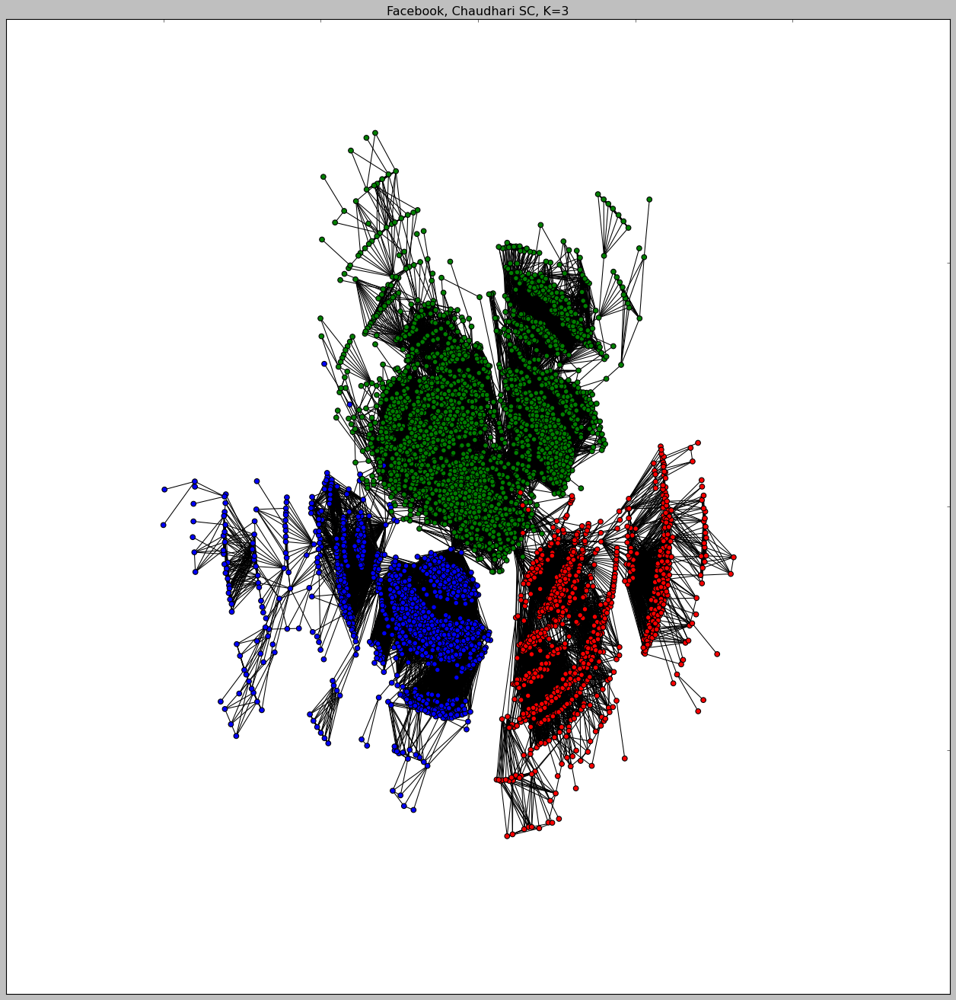

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Chaudhari SC, K=3")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels_chud[:,1]),
                 pos=facebook_layout)
plt.savefig("figC_fb_csc_k3.png", dpi = 400)

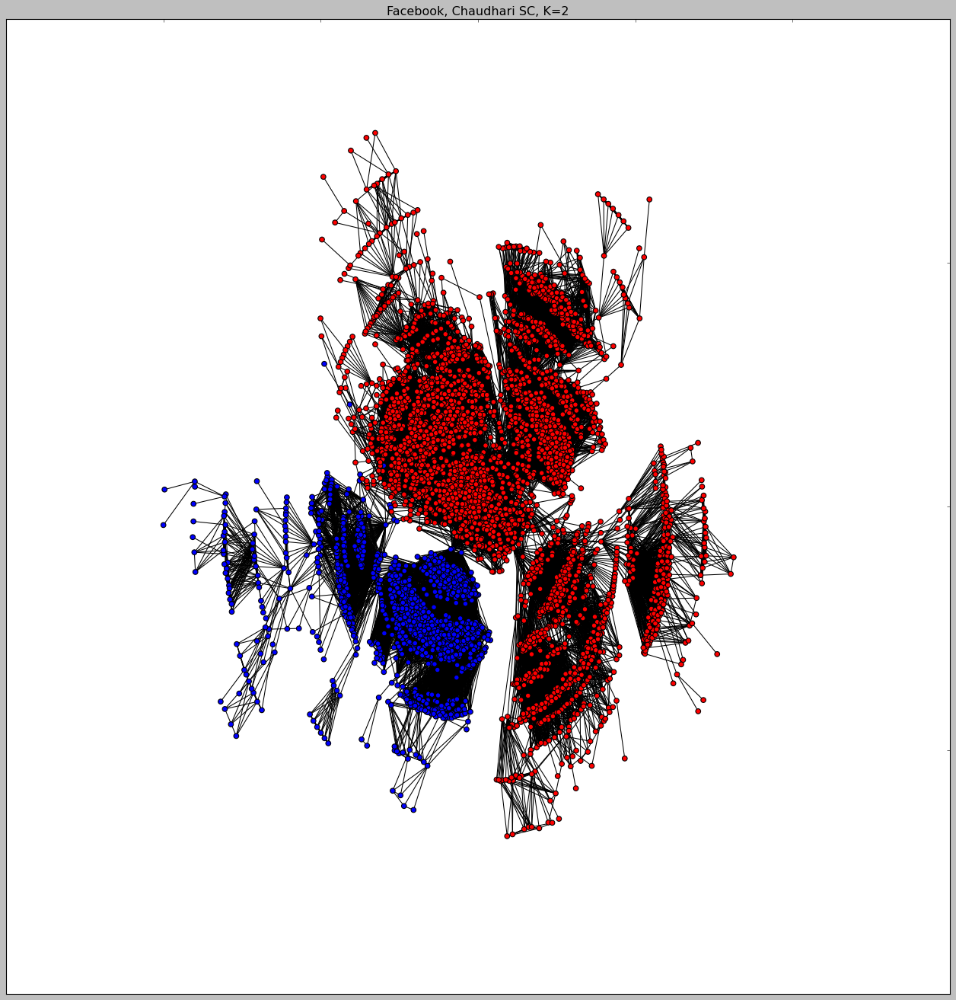

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Chaudhari SC, K=2")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels_chud[:,0]),
                 pos=facebook_layout)
plt.savefig("figC_fb_csc_k2.png", dpi = 400)

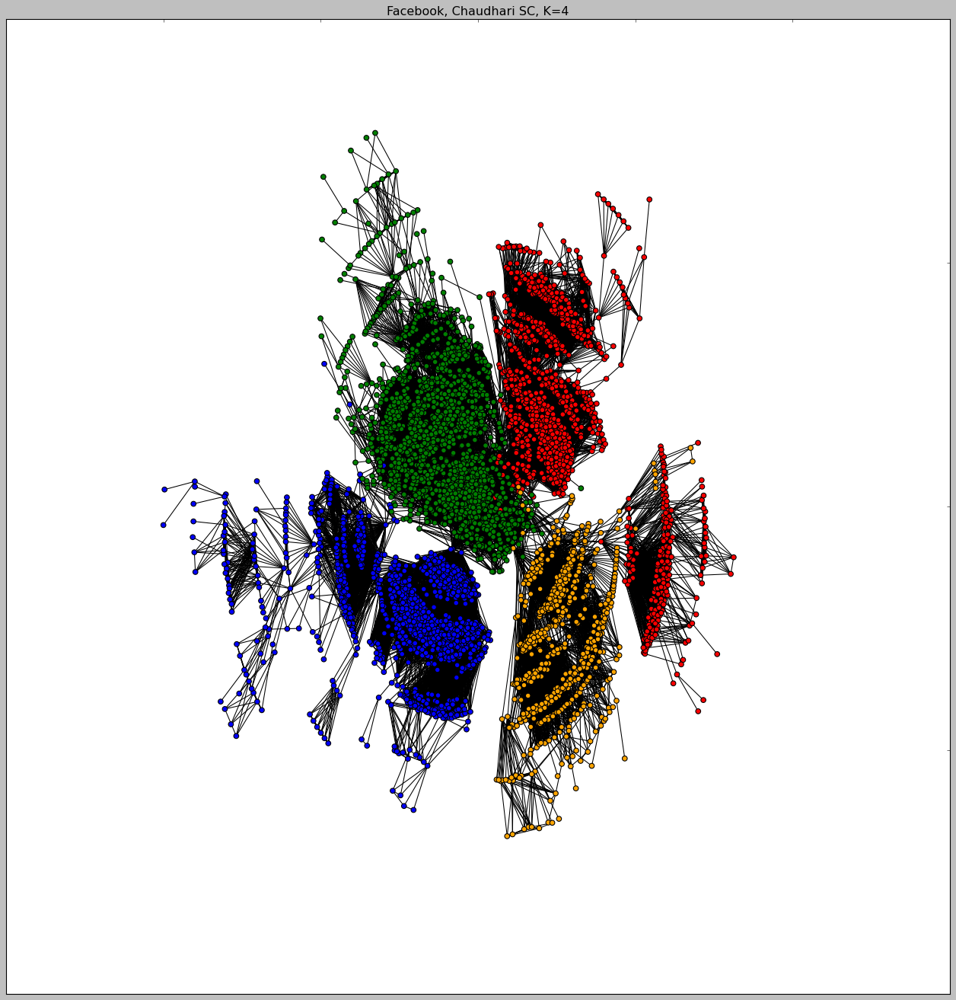

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Facebook, Chaudhari SC, K=4")
nx.draw_networkx(facebook_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(fb_labels_chud[:,2]),
                 pos=facebook_layout)
plt.savefig("figC_fb_csc_k4.png", dpi = 400)

In [ ]:
print(fb_labels_vanilla[:,0].mean())
print(fb_labels[:,0].mean())
print(fb_labels_chud[:,0].mean())

0.8143621084797555
0.7300738477209066
0.7303284950343774


### Cora

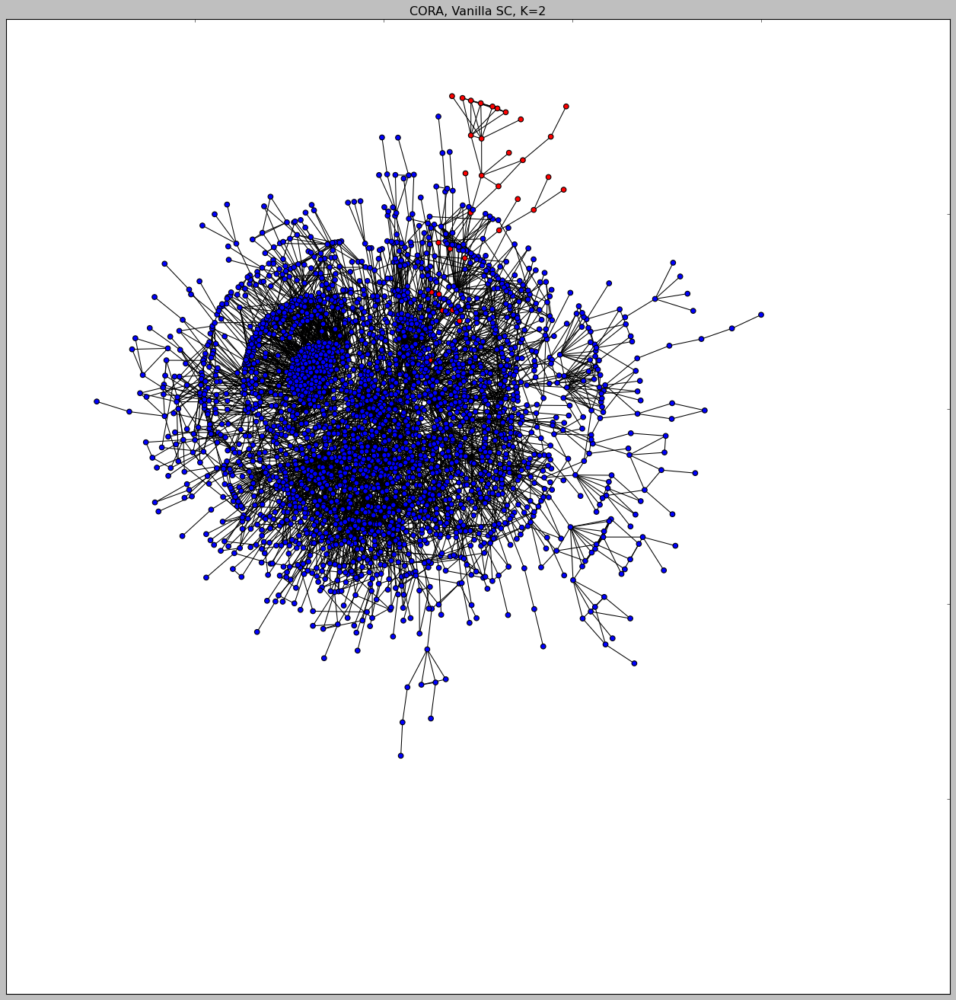

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Vanilla SC, K=2")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels_vanilla[:,0]),
                 pos=cora_layout)
plt.savefig("figC_cora_vsc_k2.png", dpi = 400)

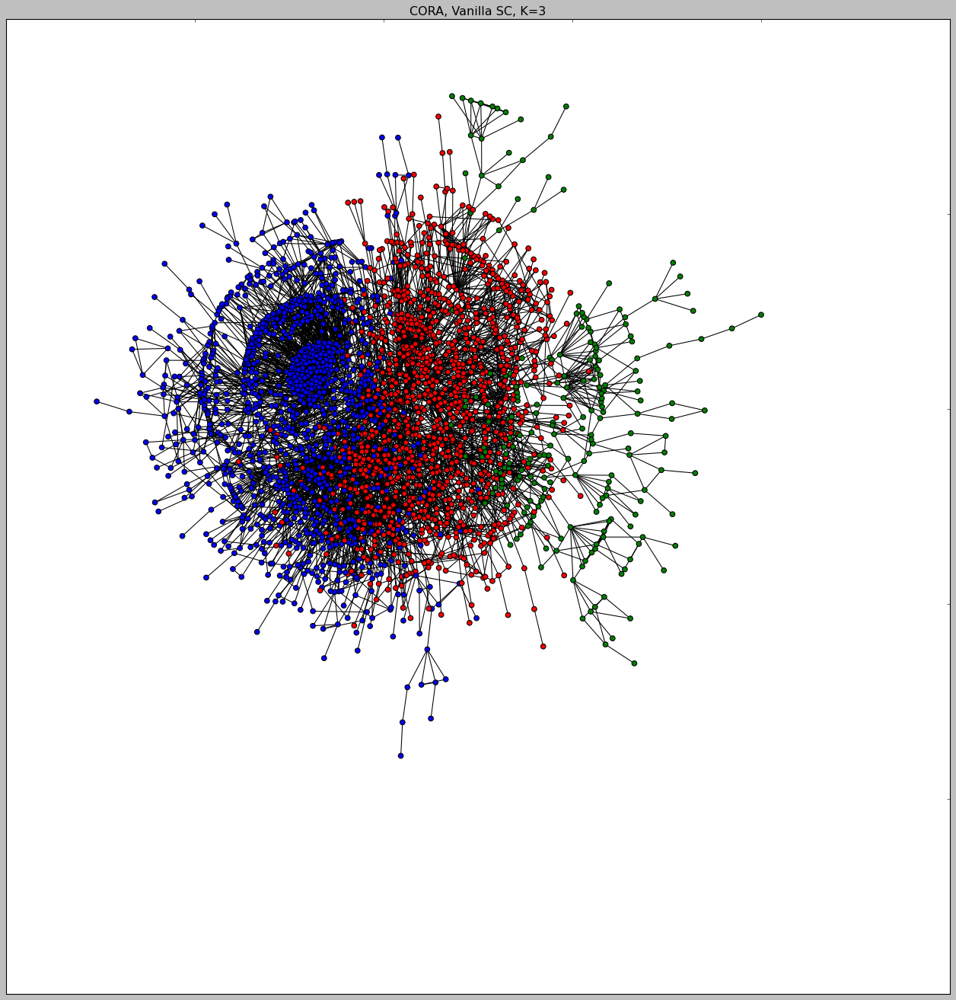

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Vanilla SC, K=3")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels_vanilla[:,1]),
                 pos=cora_layout)
plt.savefig("figC_cora_vsc_k3.png", dpi = 400)

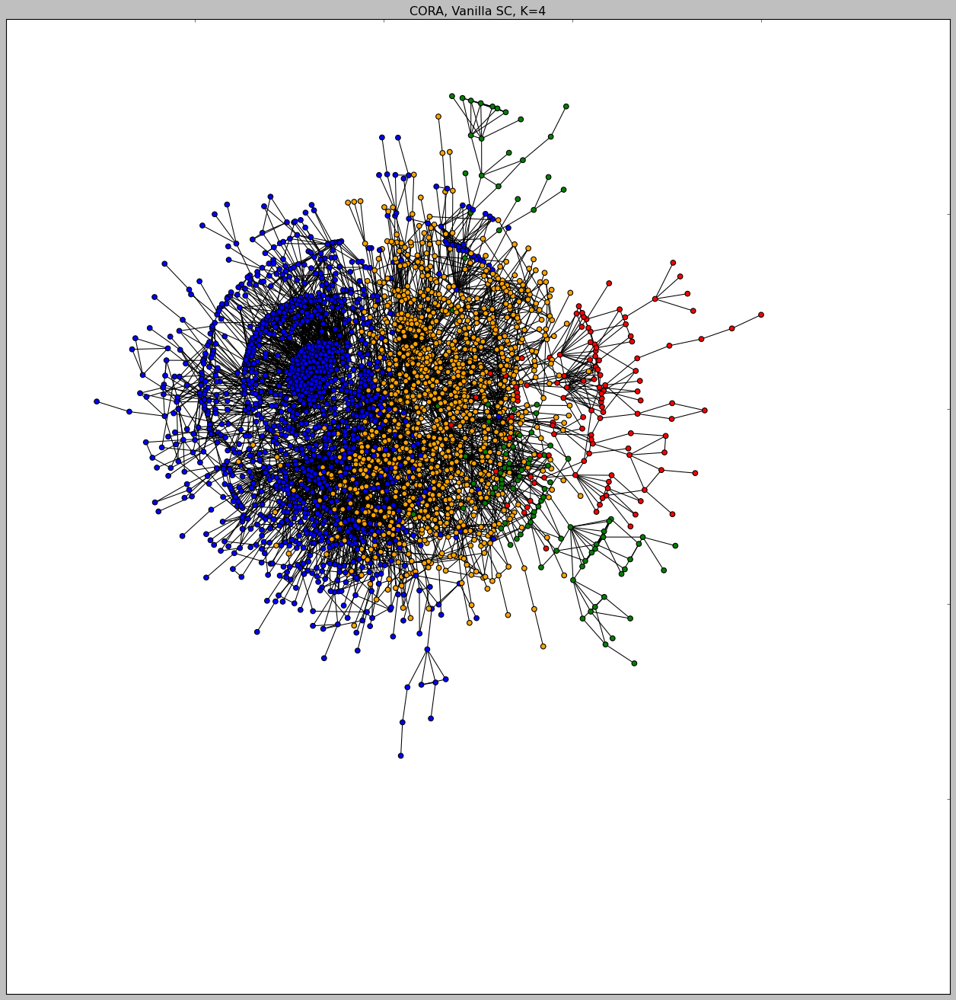

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Vanilla SC, K=4")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels_vanilla[:,2]),
                 pos=cora_layout)
plt.savefig("figC_cora_vsc_k4.png", dpi = 400)

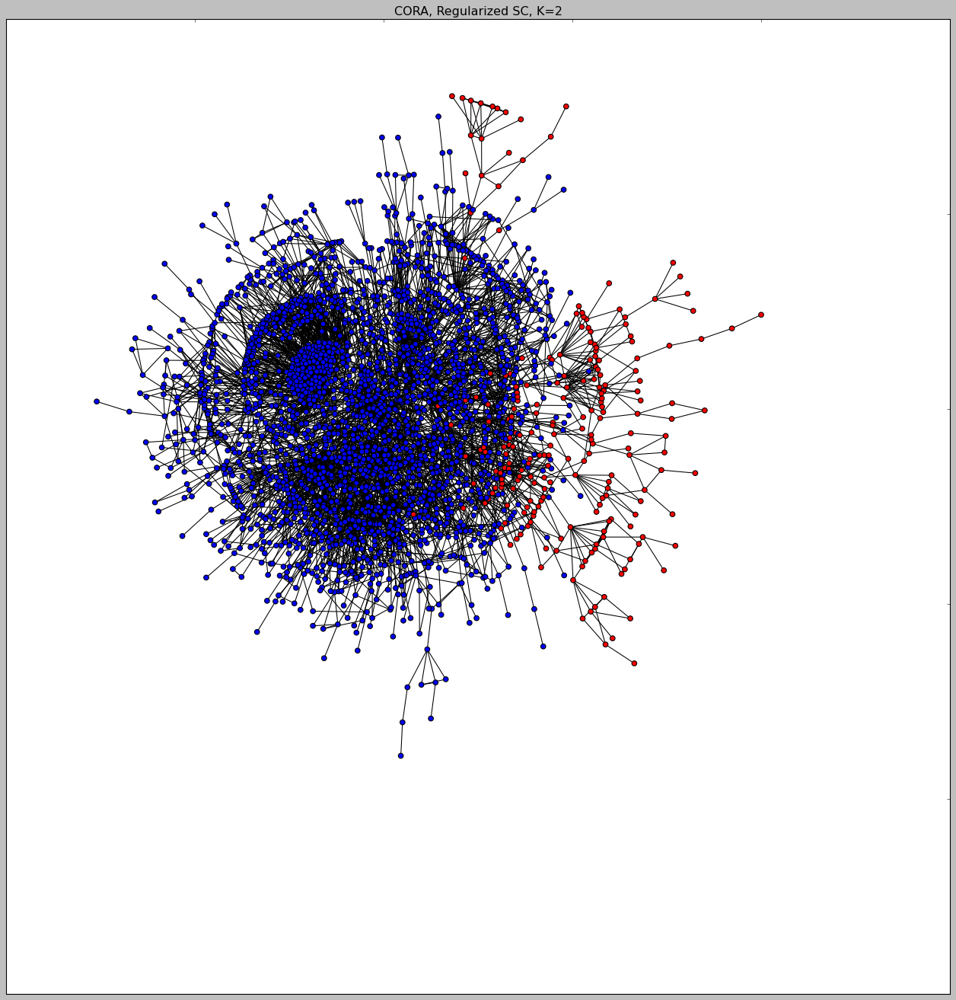

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Regularized SC, K=2")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels[:,0]),
                 pos=cora_layout)
plt.savefig("figC_cora_rsc_k2.png", dpi = 400)

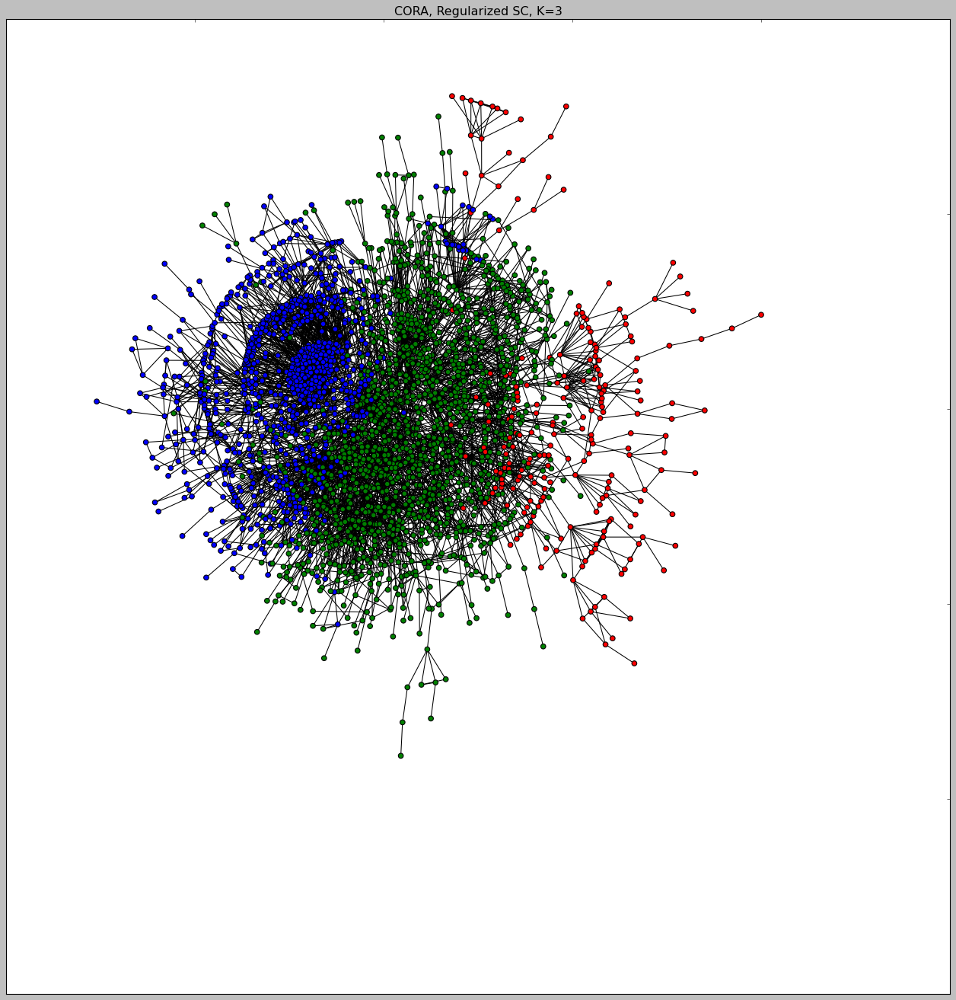

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Regularized SC, K=3")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels[:,1]),
                 pos=cora_layout)
plt.savefig("figC_cora_rsc_k3.png", dpi = 400)

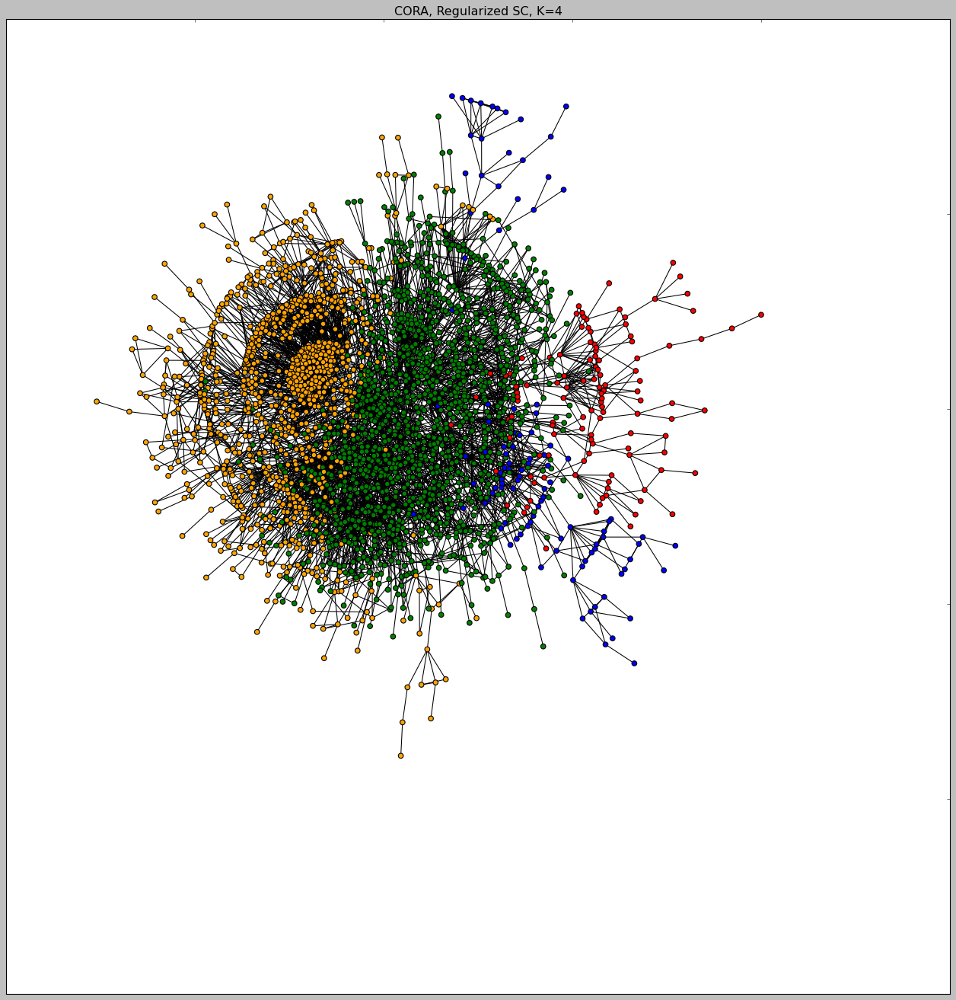

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Regularized SC, K=4")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels[:,2]),
                 pos=cora_layout)
plt.savefig("figC_cora_rsc_k4.png", dpi = 400)

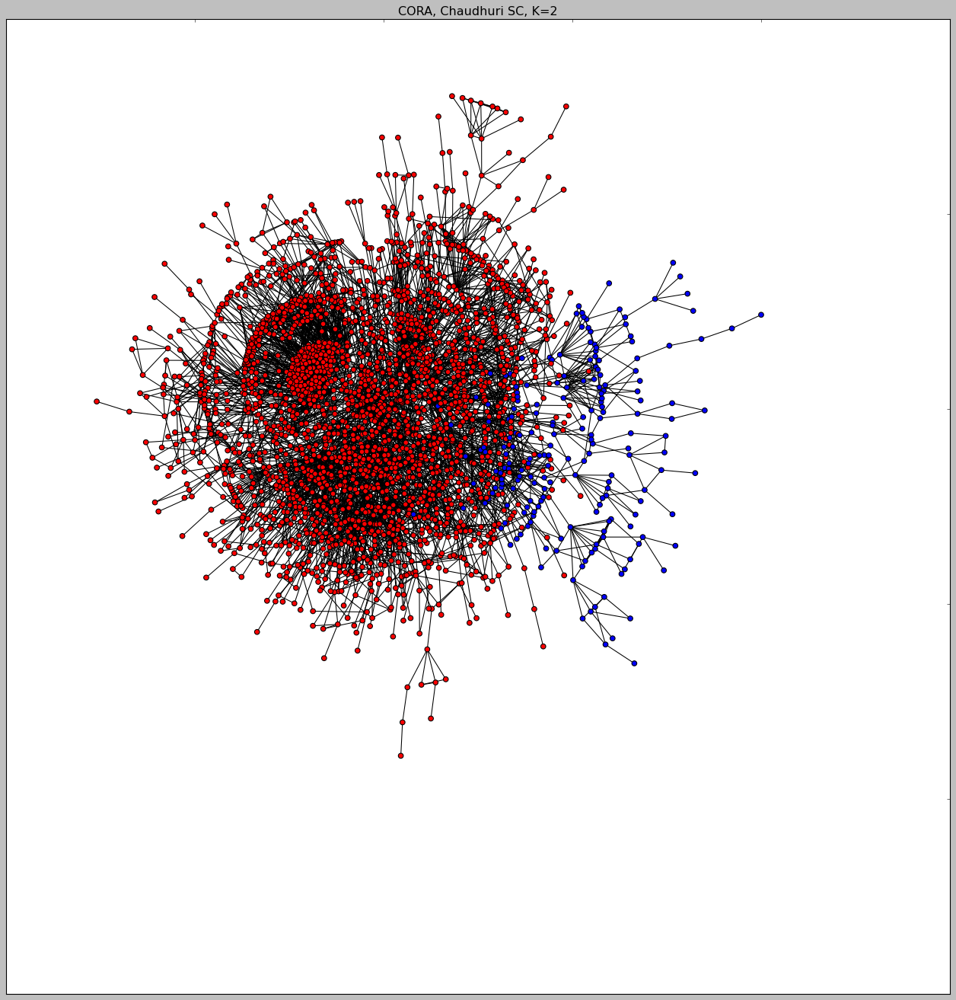

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Chaudhari SC, K=2")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels_chud[:,0]),
                 pos=cora_layout)
plt.savefig("figC_cora_csc_k2.png", dpi = 400)

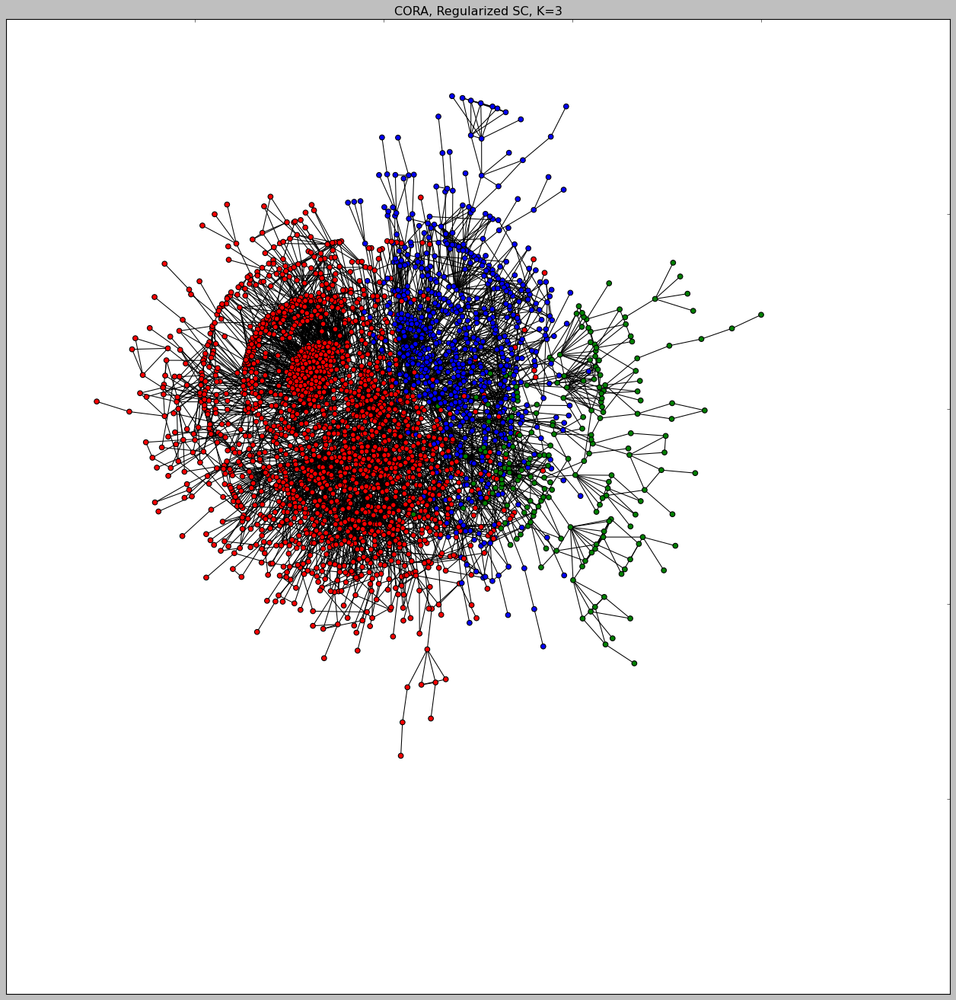

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Chaudhari SC, K=3")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels_chud[:,1]),
                 pos=cora_layout)
plt.savefig("figC_cora_rsc_k3.png", dpi = 400)

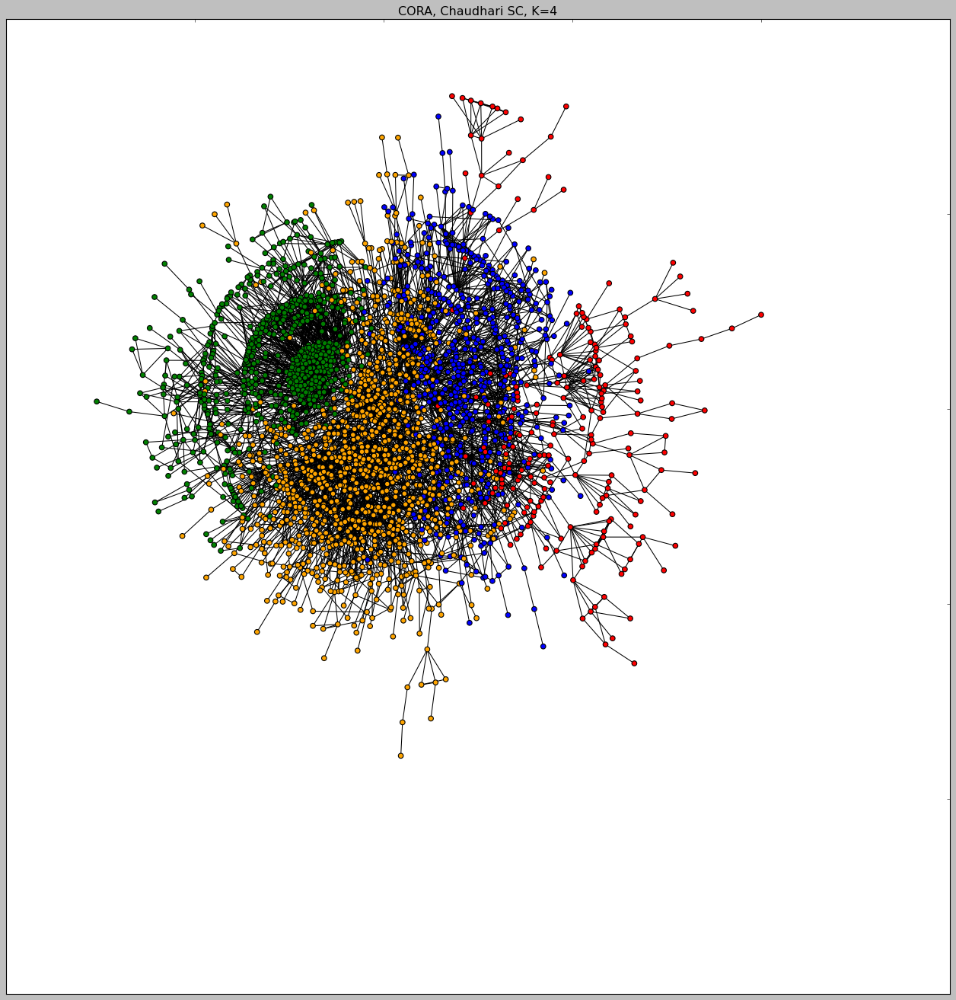

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("CORA, Chaudhari SC, K=4")
nx.draw_networkx(cora_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(cora_labels_chud[:,2]),
                 pos=cora_layout)
plt.savefig("figC_cora_csc_k4.png", dpi = 400)

In [ ]:
print(cora_labels_vanilla[:,0].mean())
print(cora_labels[:,0].mean())
print(cora_labels_chud[:,0].mean())

0.012877263581488933
0.08933601609657947
0.9195171026156942


### Twitch

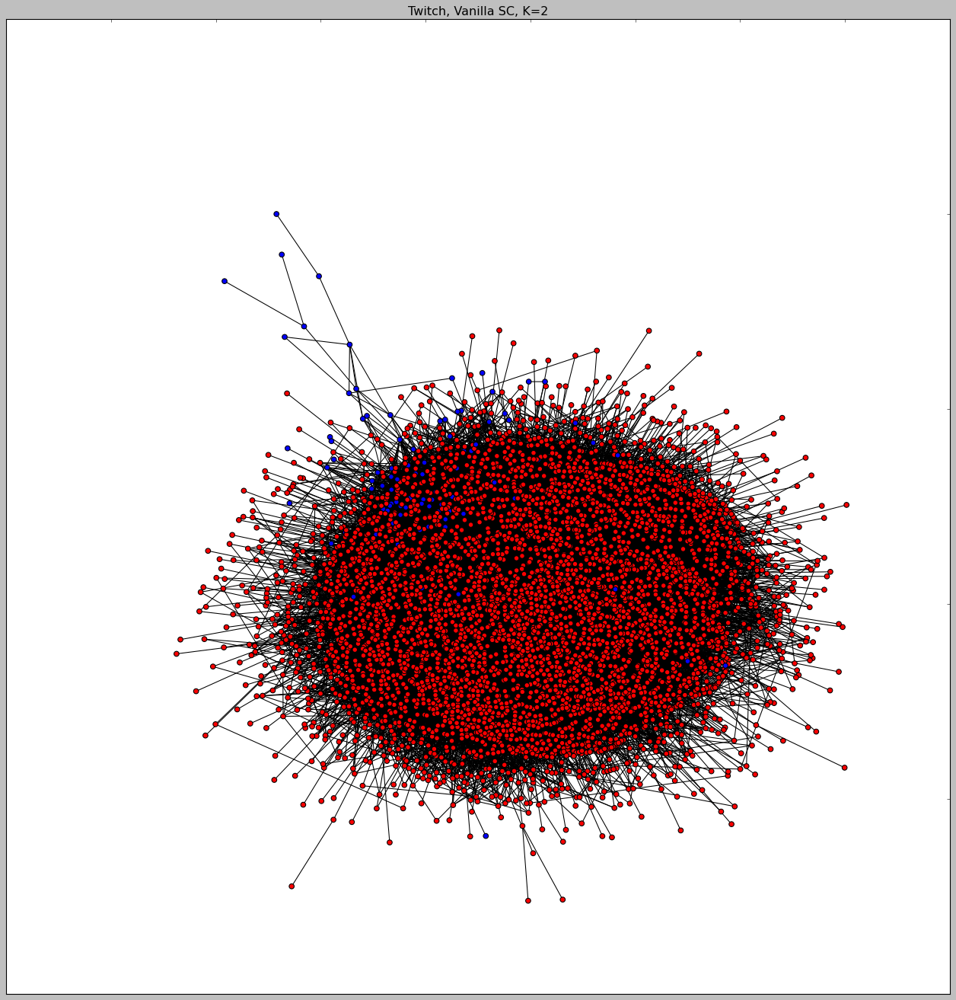

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Vanilla SC, K=2")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels_vanilla[:,0]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_vsc_k2.png", dpi = 400)

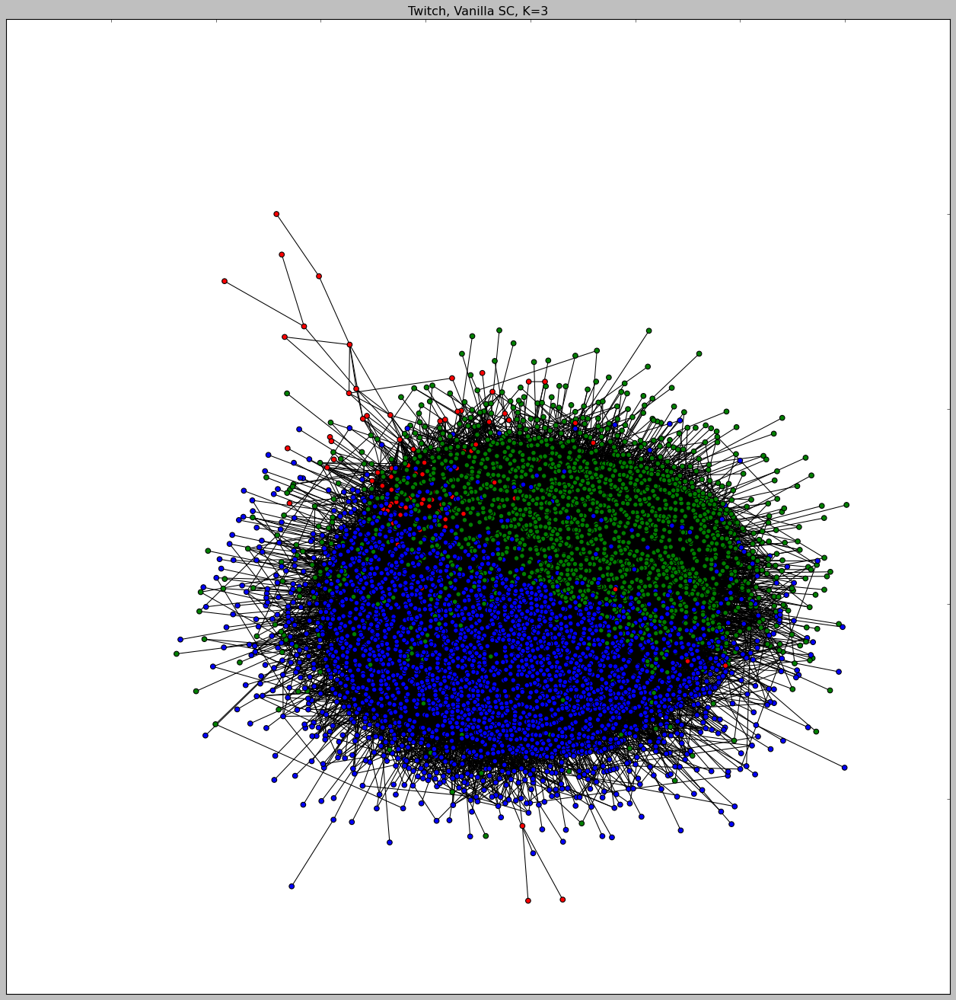

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Vanilla SC, K=3")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels_vanilla[:,1]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_vsc_k3.png", dpi = 400)

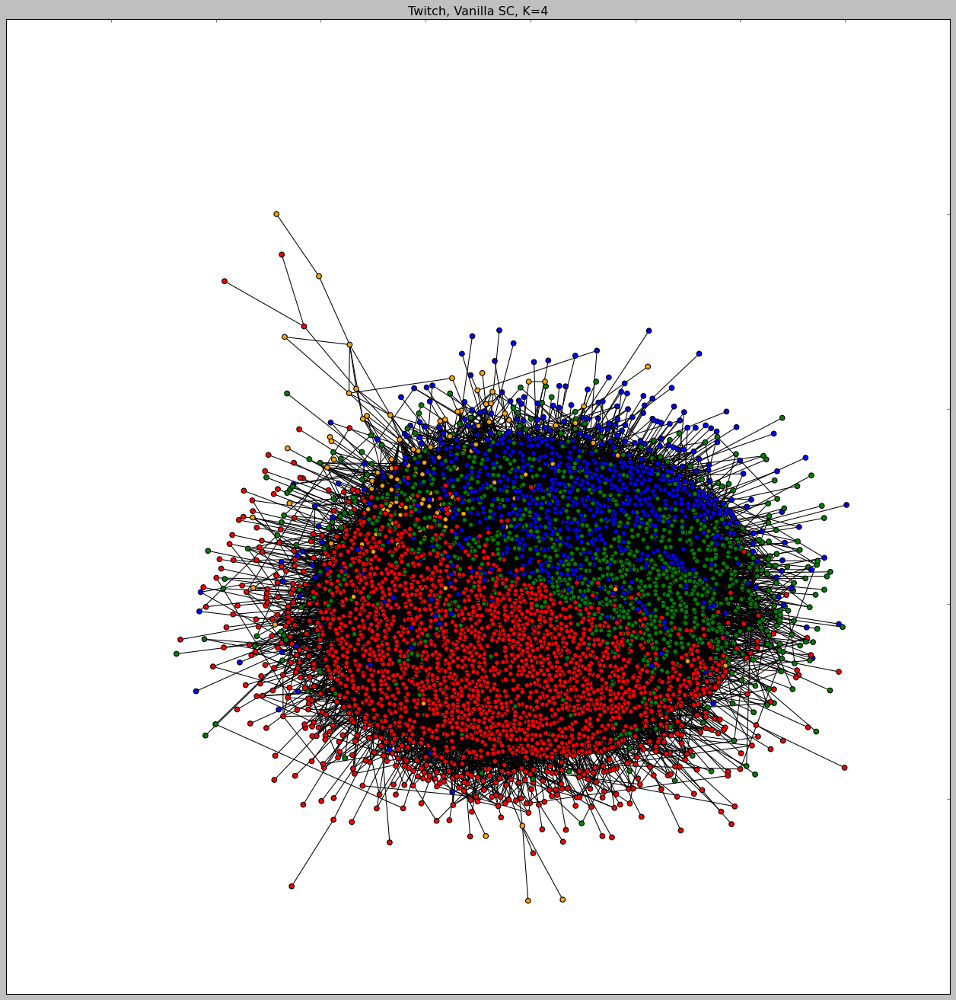

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Vanilla SC, K=4")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels_vanilla[:,2]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_vsc_k4.png", dpi = 400)

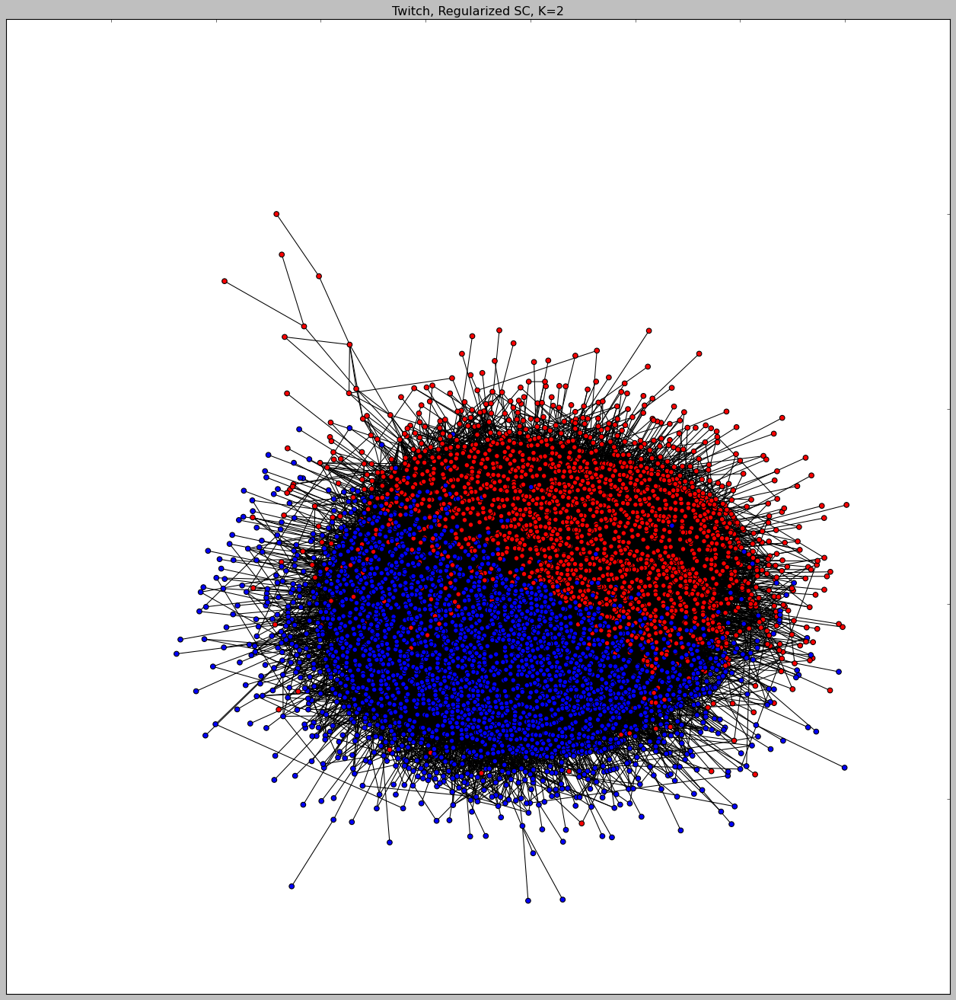

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Regularized SC, K=2")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels[:,0]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_rsc_k2.png", dpi = 400)

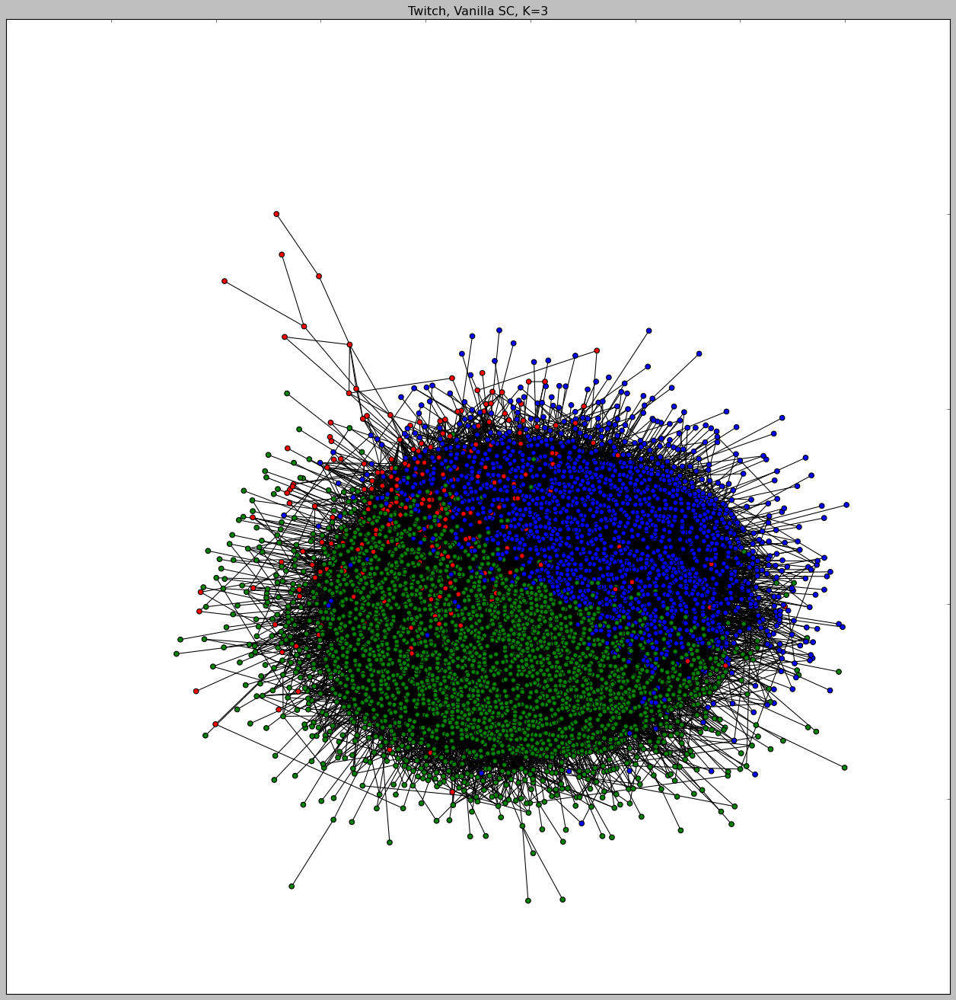

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Vanilla SC, K=3")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels[:,1]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_rsc_k3.png", dpi = 400)

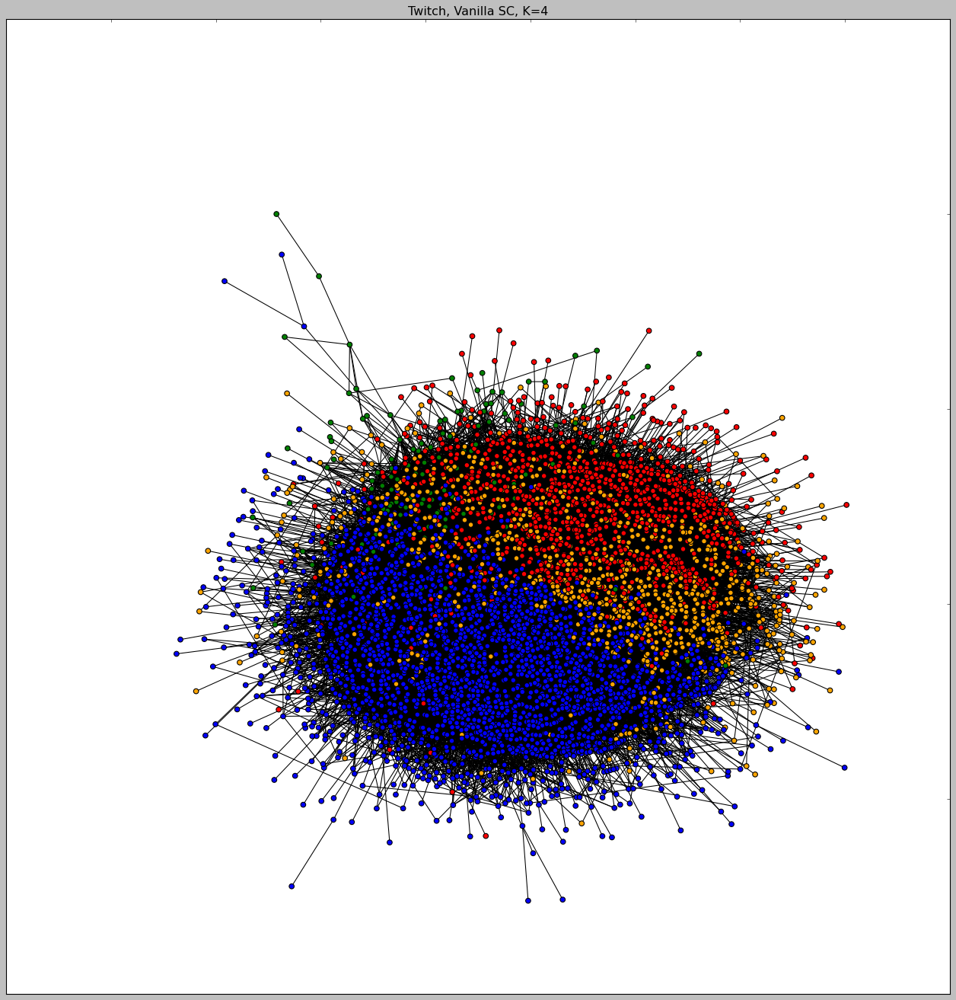

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Vanilla SC, K=4")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels[:,2]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_rsc_k4.png", dpi = 400)

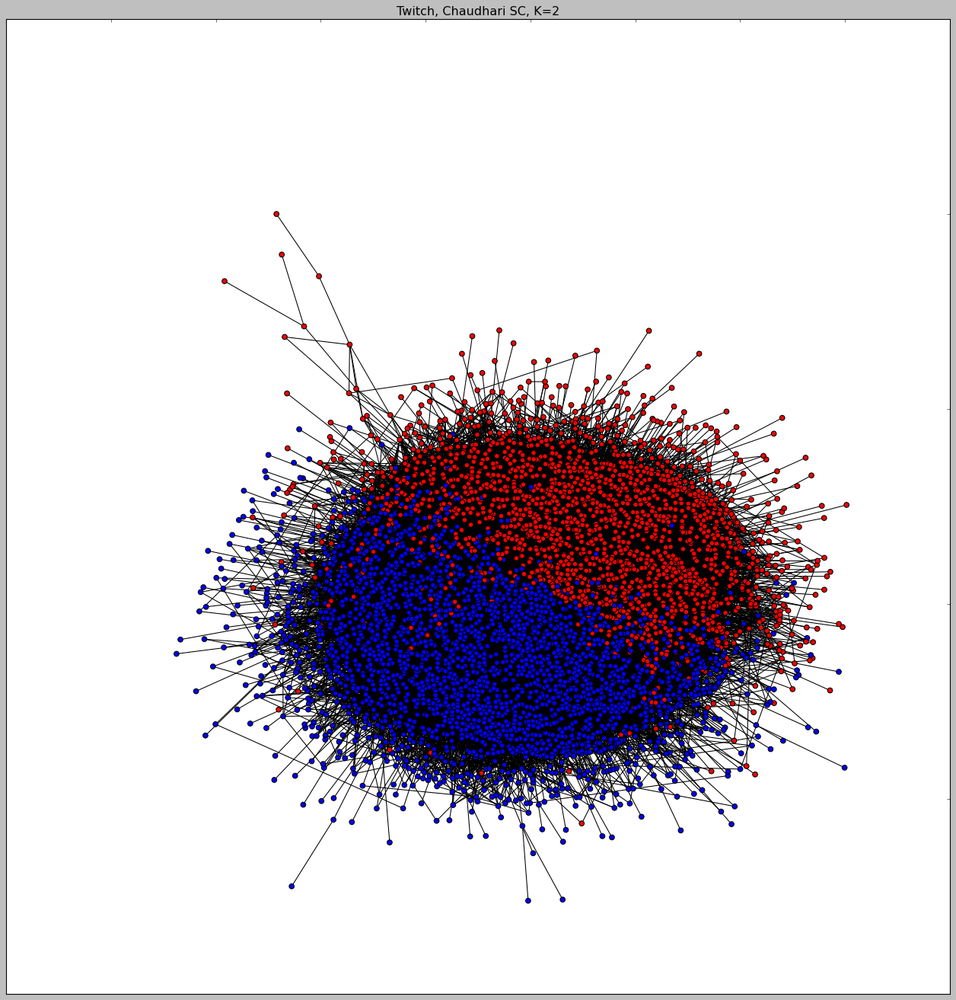

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Chaudhari SC, K=2")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels_chud[:,0]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_csc_k2.png", dpi = 400)

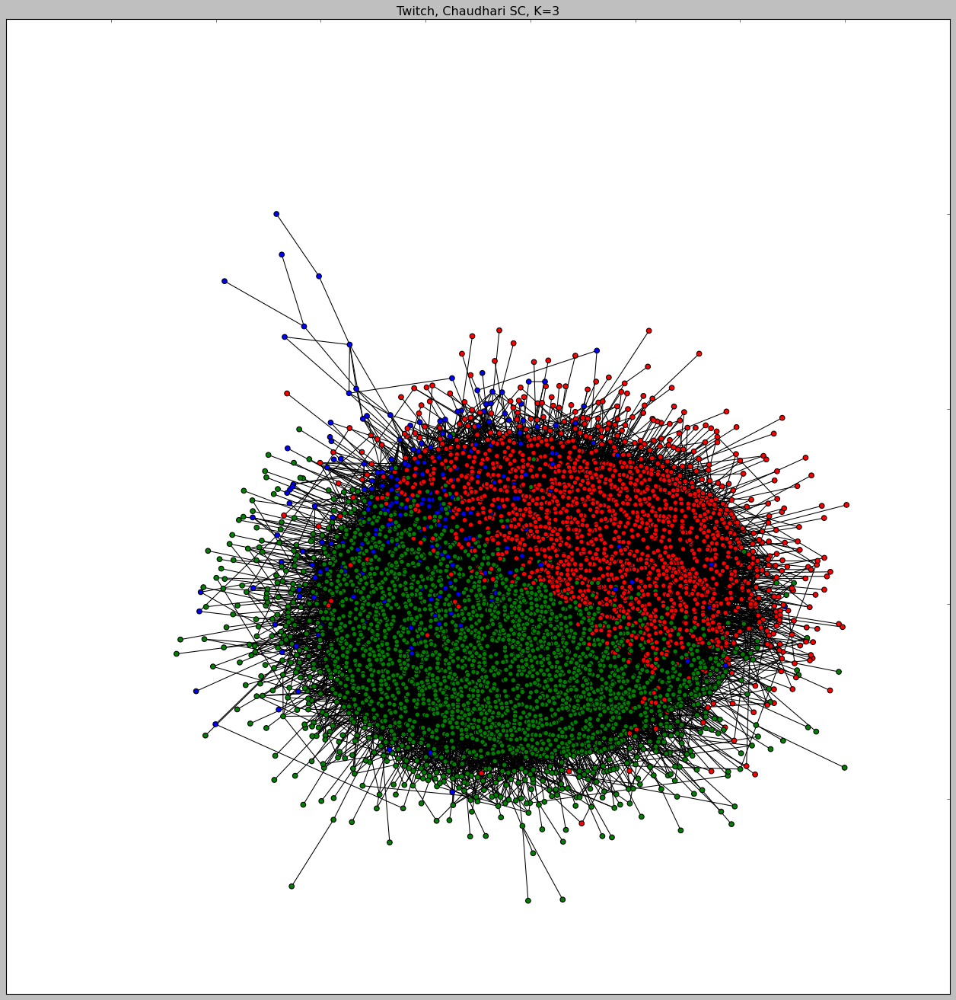

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Chaudhari SC, K=3")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels_chud[:,1]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_csc_k3.png", dpi = 400)

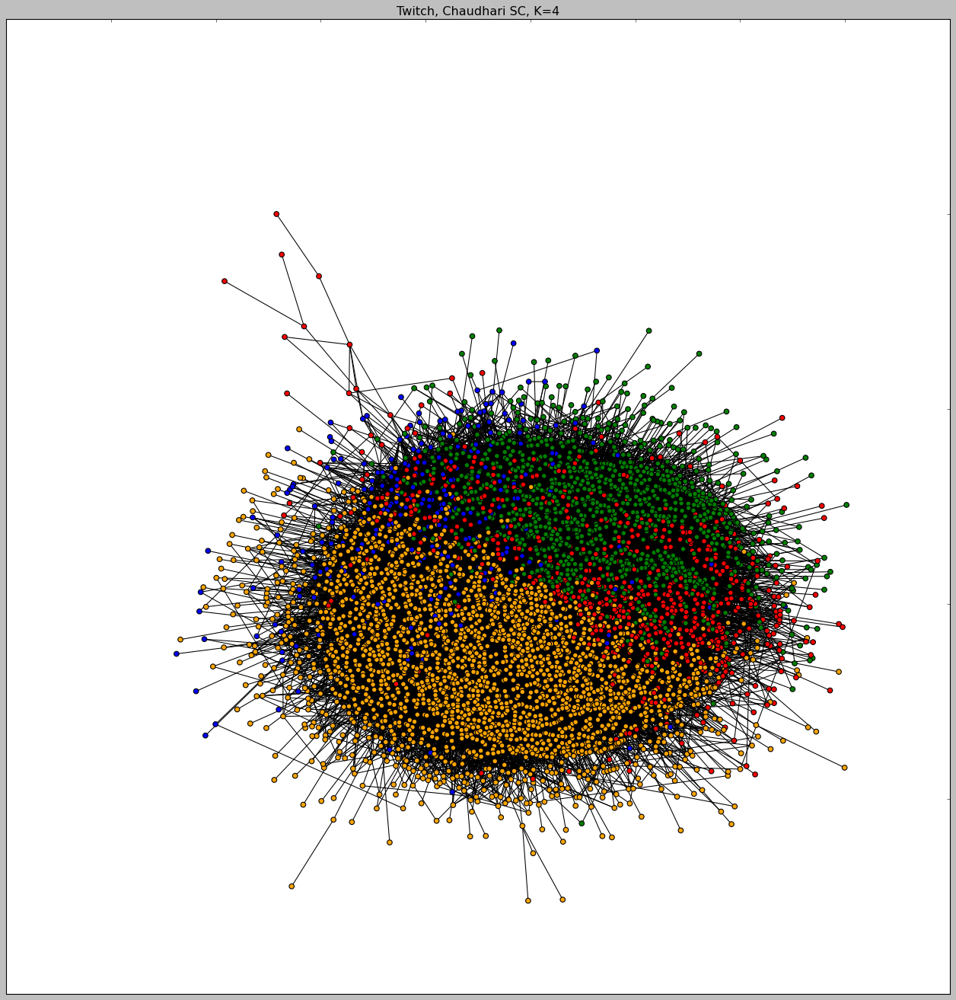

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plt.title("Twitch, Chaudhari SC, K=4")
nx.draw_networkx(twitch_graph, ax=ax, with_labels=False,
                 node_size = 35,width = 0.95,
                 node_color = node_colors(twitch_labels_chud[:,2]),
                 pos=twitch_layout)
plt.savefig("figC_twitch_csc_k4.png", dpi = 400)

## Metrics: Cluster size

In [ ]:
# Compute the size of the smallest partition
def get_min_part_size(labels):
    return min(np.sum(labels), np.size(labels) - np.sum(labels))

def get_avg_min_part_size_full(graph):

  vanilla, reg, reg_chud = [], [], []

  N = train.number_of_nodes()
  S = nx.to_numpy_matrix(train)
  tao = train.number_of_edges() * 2 / N
  SR = S + tao / N

  van_labels = spectral_clust(S)
  reg_labels = spectral_clust(SR)

  van_part.append(get_min_part_size(van_labels))
  reg_part.append(get_min_part_size(reg_labels))

  return np.mean(van_part), np.mean(reg_part), N

def graphs_part_sizes():
    van_sizes, reg_sizes, graph_sizes = [], [], []
    for graph_key in graph_map:
        print('Processing ' + graph_map[graph_key])
        van, reg, size = get_avg_min_part_size(graph_key)
        van_sizes.append(van)
        reg_sizes.append(reg)
        graph_sizes.append(size)
    return van_sizes, reg_sizes, graph_sizes

In [ ]:
np.unique(fb_labels[:,0], return_counts = True)[1]

array([1060, 2867])

In [ ]:
# Compute the size of the smallest partition
def get_min_clust_size(labels):

    N = labels.shape[0]
    min_clust = []

    for i in range(labels.shape[1]):

      _, count = np.unique(labels[:,i], return_counts = True)

      min_clust.append(np.min(count)/N)

    return np.array(min_clust)


q = ((fb_labels, fb_labels_vanilla), (cora_labels, cora_labels_vanilla), (twitch_labels, twitch_labels_vanilla))

min_size = []
for reg,vanilla in q:

  sizes = np.vstack((get_min_clust_size(vanilla), get_min_clust_size(reg)))

  min_size.append(sizes)

min_size = np.hstack(min_size)






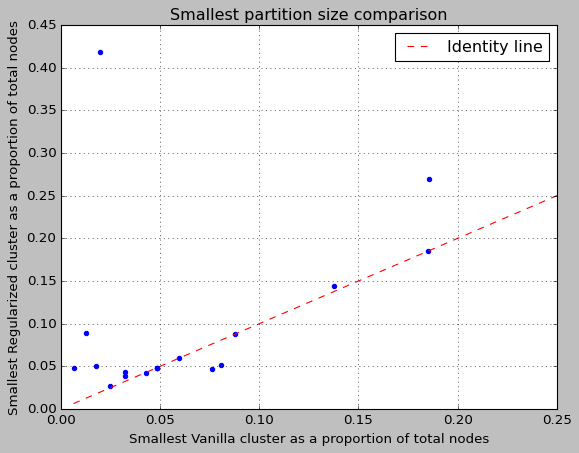

In [ ]:
plt.scatter(min_size[0,:], min_size[1,:], color='blue', marker='o',s = 15)
plt.xlabel('Smallest Vanilla cluster as a proportion of total nodes')
plt.ylabel('Smallest Regularized cluster as a proportion of total nodes')
plt.title('Smallest partition size comparison')
min_val = min(np.min(min_size[0,:]), np.min(min_size[1,:]))
max_val = max(np.max(min_size[0,:]), np.max(min_size[1,:]))
plt.xlim(0,0.25)
plt.ylim(0,0.45)
plt.plot([min_val, max_val], [min_val, max_val], '--', color='red', label='Identity line')
plt.legend()

plt.grid(True)
plt.savefig("FigD_scatter.png", dpi = 300)
plt.show()

# Part D

## Validation Split

Abandoned this idea


In [ ]:

def testval_split(graph):
  # Randomly sample edges from edges list
  random_edges = list(graph.edges())
  np.random.shuffle(random_edges)
  val_edges = random_edges[:graph.number_of_edges()//2]
  test_edges = random_edges[graph.number_of_edges()//2:]

  # Validation graph
  val_graph = nx.Graph()
  val_graph.add_edges_from(val_edges)
  val_graph = max(nx.connected_component_subgraphs(train_graph), key=len)

  # Test graph
  test_graph = nx.Graph()
  test_graph.add_nodes_from(train_graph.nodes())
  test_graph.add_edges_from(test_edges)

  return val_graph, test_graph

